# SC4061 Computer Vision Lab 1

**Point Processing + Spatial Filtering + Frequency Filtering + Imaging Geometry**

This laborary aims to introduce image processing, supposedly in the MATLAB context. But we are using Python here. We will:
1. Experiment with the point processing operations of contrast stretching and histogram equalization
2. Evaliate how different Gaussian and median filters are suitable for noise removal
3. Become familiar with the frequency domain operations
4. Understand imaging geometry

---

## 1.0 Importing Dependencies and Helper Function Declarations

In [1]:
# Import dependencies, the typical stuff
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import scipy # Used for convolutions
import cv2

# Stop scientific notation
np.set_printoptions(suppress=True)
# Lower dpi of plt figures to save space
plt.rcParams['figure.dpi'] = 80

In [2]:
# Reimport just for redundancy
import cv2
import matplotlib.pyplot as plt

# Helper function to load images, we are mainly working with greyscale images this lab
def load_image(path, is_greyscale = True):
    image = cv2.imread(path)
    if image is not None:
        image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY) if is_greyscale else cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    return image

# Helper function to display images, we will use this a lot
def display_image(image, figsize = (10, 10), title = "Image", vmin = None, vmax = None, grey = True):
    cmap_v = "gray" if grey else None
    if image is None:
        return
    plt.figure(figsize = figsize)
    plt.imshow(image, cmap = cmap_v, vmin = vmin, vmax = vmax)
    plt.title(title)
    plt.show()

# Helper function to display two images side by side for comparison
def display_images_side_by_side(image1, image2, title1="Image 1", title2="Image 2", figsize=(15, 6)):
    if image1 is None or image2 is None:
        print("One or both images are None")
        return
    
    fig, axes = plt.subplots(1, 2, figsize=figsize)
    
    # Display first image
    axes[0].imshow(image1, cmap='gray')
    axes[0].set_title(title1, fontsize=14)
    
    # Display second image
    axes[1].imshow(image2, cmap='gray')
    axes[1].set_title(title2, fontsize=14)
    
    plt.tight_layout()
    plt.show()

def print_image_info(image, image_name="Image"):
    if image is None:
        return
    
    # Create a dictionary with image information
    info_data = {
        'Property': [
            'Shape',
            'Data Type',
            'Total Pixels',
            'Dimensions',
            'Memory Usage (bytes)',
            'Min Pixel Value',
            'Max Pixel Value',
            'Mean Pixel Value',
            'Standard Deviation'
        ],
        'Value': [
            str(image.shape),
            str(image.dtype),
            f"{image.size:,}",
            image.ndim,
            f"{image.nbytes:,}",
            image.min(),
            image.max(),
            f"{image.mean():.2f}",
            f"{image.std():.2f}"
        ]
    }
    
    # Create and display the table
    df = pd.DataFrame(info_data)
    print(f"{image_name} Information:")
    print("=" * 40)
    print(df.to_string(index=False, justify='left'))
    print("=" * 40)
    

## 1.1 Contrast Stretching

### Part A and B - Loading of image and converting to greyscale

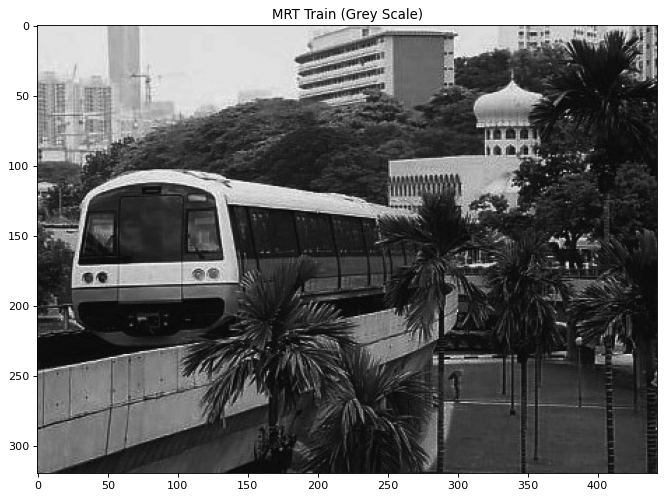

In [3]:
# Part A and B: Loading of image and converting to greyscale
# Loading of iamge into variable as described by lab manual
P = load_image("../assets/mrt-train.jpg")
# Displaying the image
display_image(P, title = "MRT Train (Grey Scale)")

### Part C - Checking minimum and maximum intensities present in the image

In [4]:
# Also print out some statistics about image
print_image_info(P)

Image Information:
Property             Value     
               Shape (320, 443)
           Data Type      uint8
        Total Pixels    141,760
          Dimensions          2
Memory Usage (bytes)    141,760
     Min Pixel Value         13
     Max Pixel Value        204
    Mean Pixel Value      73.99
  Standard Deviation      49.56


### Part D - Performing Contrast Stretching

In contrast stretching, we want to increase an image's contrast by expanding its pixel intensity values to fill a wider range, such as the full spectrum of 0 to 255 for an 8-bit image. In the current image, our minimum and maximum pixel intensities are 13, and 204 respectively.

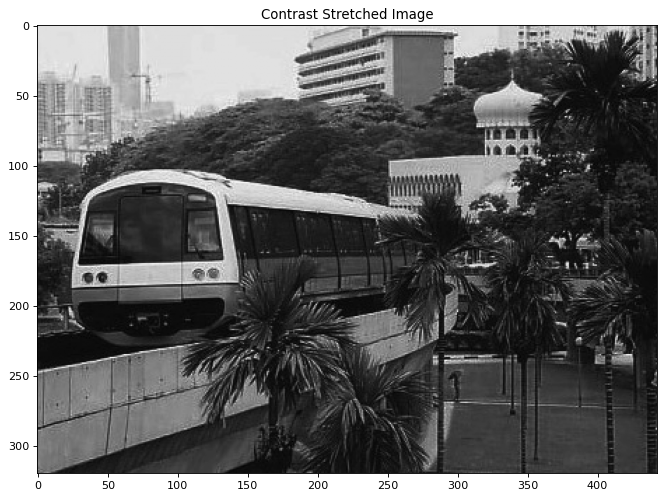

Contrast Stretched Image Information:
Property             Value     
               Shape (320, 443)
           Data Type    float64
        Total Pixels    141,760
          Dimensions          2
Memory Usage (bytes)  1,134,080
     Min Pixel Value        0.0
     Max Pixel Value      255.0
    Mean Pixel Value      81.43
  Standard Deviation      66.17


In [5]:
# Create newly contrast stretched image using the min and max values specifically
P2 = (P - P.min()) / (P.max() - P.min()) * 255.0
# Display the newly contrast stretched image and its information
display_image(P2, title = "Contrast Stretched Image")
print_image_info(P2, "Contrast Stretched Image")

Observations: The pixel with the leaset intensity, is now a value of 0. The pixel with the highest intensity is now 255, with all pixels in between these ranges scaled in propoertion. The pixel intensities will now fully utilize the uint8 range (0-255), which has enhanced the image contrast.

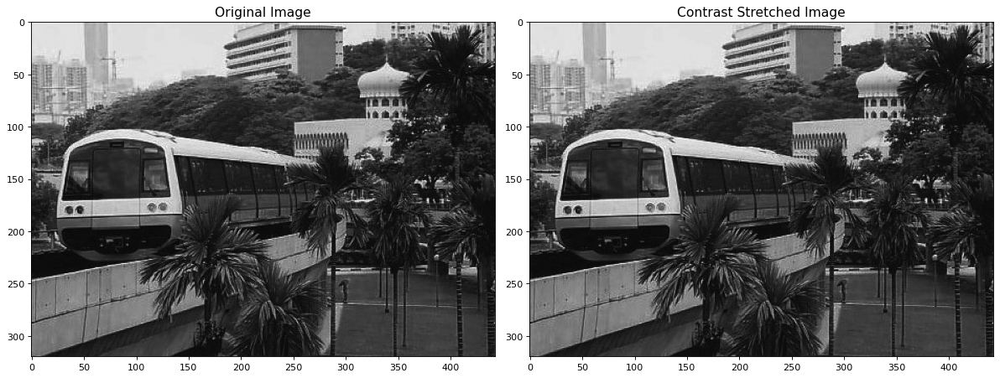

In [6]:
display_images_side_by_side(P, P2, title1 = "Original Image", title2 = "Contrast Stretched Image")

---
## 1.2 Histogram Equalization

Histogram equalization typically involves nonlinearly mapping some gray levels to other levels, in order to create a resultant histogram which is approximately uniform. In image processing, it typcially improves an image's contrast by redistributing its pixel intensity values through analysis of its intensity histogram to create a transformation function that stretches the distribution to occupy the full possible range. This may or may not enhance detail and visibility in images with a narrow range of intensities.

### Part A - Displaying of intensity histogram with 256 and 10 bins

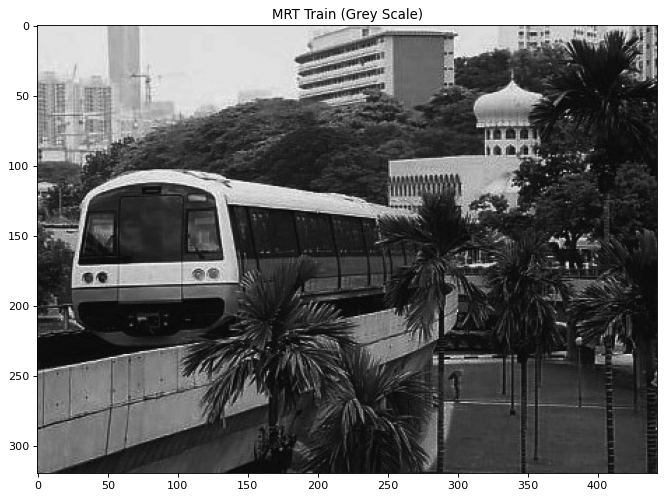

Original Image Information:
Property             Value     
               Shape (320, 443)
           Data Type      uint8
        Total Pixels    141,760
          Dimensions          2
Memory Usage (bytes)    141,760
     Min Pixel Value         13
     Max Pixel Value        204
    Mean Pixel Value      73.99
  Standard Deviation      49.56


In [7]:
# Reload the image P again to get saved state
# This will be using the image with the min itensity 13 and max intensity 204
P = load_image("../assets/mrt-train.jpg")
display_image(P, title = "MRT Train (Grey Scale)")
print_image_info(P, "Original Image")

In [8]:
def plot_intensity_histogram(image, bins, range = (0, 255), title = "Image"):
    # I think we can also use flatten over ravel - but flatten does occupy memory so we use ravel here for simplicity
    plt.hist(image.ravel(), bins = bins, range = range)
    plt.title(f"{title} ({bins} bins)")
    plt.xlabel("Pixel Intensity")
    plt.ylabel("Frequency")
    plt.show()

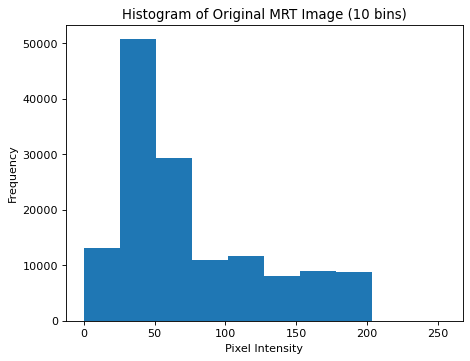

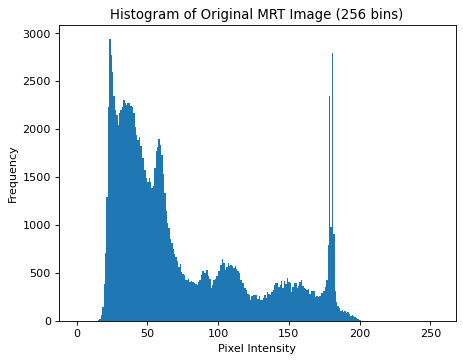

In [9]:
# Plotting out intensity histogram with 10 bins
plot_intensity_histogram(P, 10, (0, 255), "Histogram of Original MRT Image")
# Plotting out intensity histogram with 256 bins
plot_intensity_histogram(P, 256, (0, 255), "Histogram of Original MRT Image")

**Differences between a histogram with 10 bins and 256 bins**
The key difference between both histograms is ultimately the granularity of detail.

In the 10 bins histogram: It groups 256 possible intesity values into just 10 broad categories (with each bin covering ~25-26 intensity levels), giving a simplified and high level view of the distribution. It allows us to make the inference that the image is predominantly dark with a gradual decrease towards brighter values.

In the 256 bins histogram: Each individual intensity value is shown seperately, revealing fine-grained details that the 10-bin version misses. Specifically, we can see a bimodal distribution with a large peak around intensity 20-50 (the dark train/background) and a distinct spike around intensity 200 (likely the bright train lights or signage).

While the 10-bin histogram is useful for quick analysis and identifying general trends, the 256-bin histogram provides the complete picture which is necessary for precise analysis like histogram equalization, where we may need to know exactly how many pixels exist at specific intensity level in order for proper redistribgution across the 0-255 range. Since the range is small, it is still okay to have a histogram for each bin at small computational cost.

### Part B - Histogram Equalization on Image

Since we are not using MATLAB, as part of cv2's docs, it comes with histogram equalization: https://docs.opencv.org/4.x/d5/daf/tutorial_py_histogram_equalization.html
https://docs.opencv.org/4.x/d6/dc7/group__imgproc__hist.html#ga7e54091f0c937d49bf84152a16f76d6e

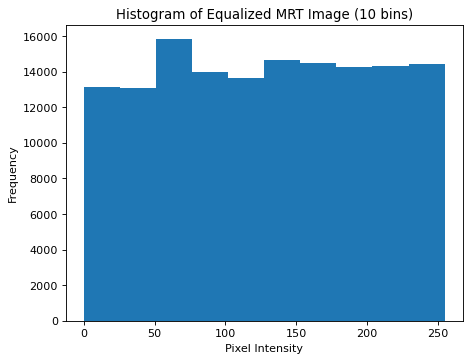

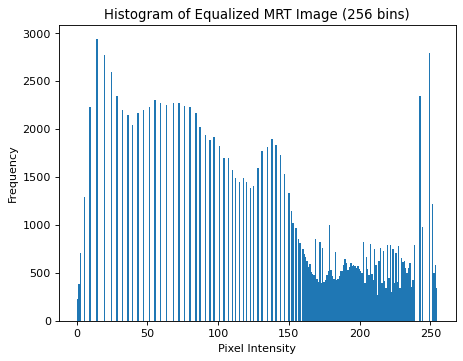

In [10]:
# Use cv2's histogram equalization
P3 = cv2.equalizeHist(P)

# Redisplay the histograms for P3 with 10 and 256 bins
plot_intensity_histogram(P3, 10, (0, 255), "Histogram of Equalized MRT Image")
plot_intensity_histogram(P3, 256, (0, 255), "Histogram of Equalized MRT Image")

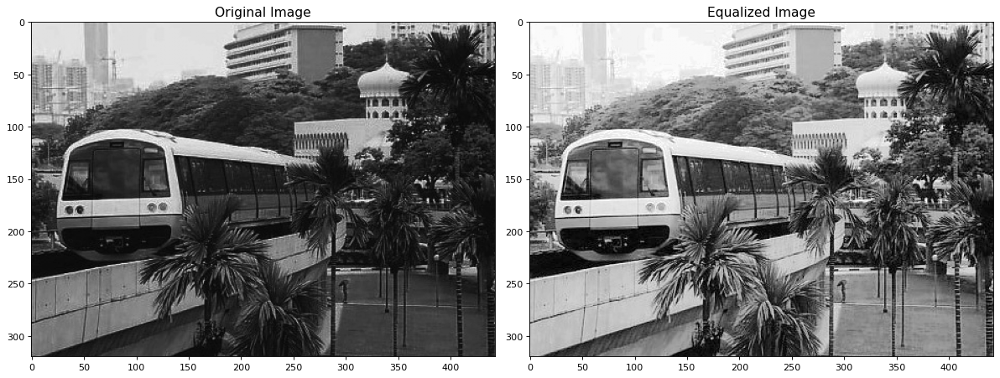

In [11]:
# Displaying the image after histogram equalization
display_images_side_by_side(P, P3, title1 = "Original Image", title2 = "Equalized Image")

**Are the histograms equalized? What arre the similarities and differences between the latter two histograms?**

In general, both histograms look more equalizzed than the original two image intensity histograms.

After equalization, the histograms show partial equalization rather than perfect uniformity. The 10-bin histogram appears much more equalized, with frequencies relatively around 13,000 to 15,000 pixels per bin across most of the intensity range, which is close to the ideal uniform ditribution. However, the 256-bin histogram reveals that perfect equalization was not achieved. While the intensity values are now spread across the full 0-255 range, still an improvement compared to the original clustered distribution, there is significant variation with many spikes, gaps and bins with zero pixels.

Still, the key similarity is that both histograms show intensity values distributed across the entire range rather than concentrated in dark regions like the original intensity histogram. In the image, we can also see that there are lesser gaps in the brighter area of pixel intensitgies, causing the resulting image to look brighter than the original.

### Part C - Rerunning of Histogram Equalization

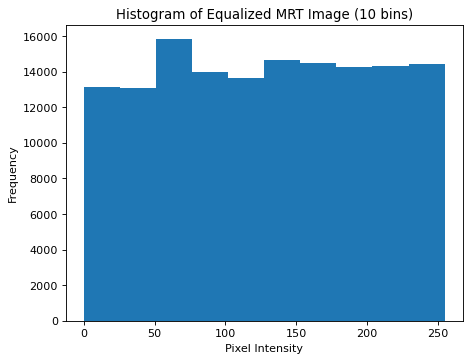

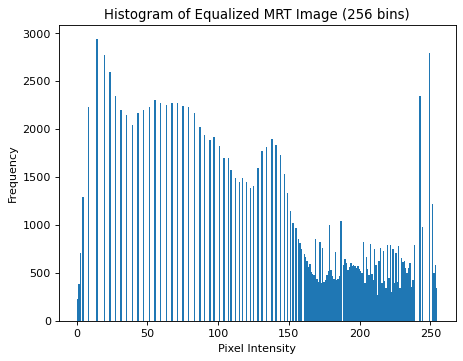

In [12]:
# Re-equalize hist on the equalized image
P4 = cv2.equalizeHist(P3)
# Redisplay the histograms for P4 with 10 and 256 bins
plot_intensity_histogram(P4, 10, (0, 255), "Histogram of Equalized MRT Image")
plot_intensity_histogram(P4, 256, (0, 255), "Histogram of Equalized MRT Image")

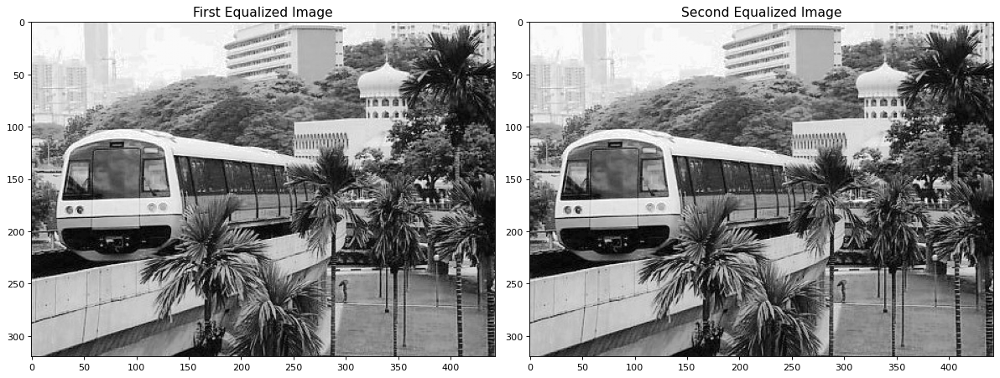

In [13]:
display_images_side_by_side(P3, P4, title1 = "First Equalized Image", title2 = "Second Equalized Image")

**Does the histogram become more uniform? Give suggestions as to why this occurs**

From analysis, the histograms show virtually no change compared to the first equalizations, they look nearly indentical. The histogram does not become more uniform after re-applying histogram. This occurs because histogram equalization is idempotent (applying it multiple time actually produces the same result as applying it once). Once pixel intensities have been redestributed to approximate a uniform distribution, the CDF of the equalized image is already approximately linear. If we reapply the transformation again, we are essentiall applying a near-identity transformation that maps most pixels back to or close to their current intensity values. This is partly due to the discrete nature of digital images, we cannot split bins that had multiple original intensity values merged, and we cannot fill empty bins where no pixels exist. Since the first equalization already maximally spread the available intensities across the 0-255 range, subsequent equalizations cannot improve uniformity further.

---
## 1.3 Linear Spatial Filtering

In linear spatial filtering, typically an input image f(x,y) is convolved with a small spatial filter
h(x,y) to create an output image g(x,y),
The function h(x,y) can be considered to be the impulse response of the filter system.
Another common name for h(x,y) is the point-spread function (PSF).

### Part A - Generate Gaussian Filters with Normalization

In [14]:
# Generate Gaussian filters using the formula: h(x,y) = (1/2πσ²) * e^(-(x²+y²)/2σ²)
# Size = dim of filter
# Sigma = how spread out the gaussian is , larger sigma = larger blur
def gaussian_filter(size, sigma):
    # Create coordinate grid centered at (0,0)
    # [-2, -1, 0, 1, 2] if size is 5
    axes = np.linspace(-(size//2), size // 2, size)
    # Create a mesh grid of the coordinates
    x, y = np.meshgrid(axes, axes)
 
    # formula: h(x,y) = (1/2πσ²) * e^(-(x²+y²)/2σ²)
    # First expression
    first_expn = 1.0 / (2.0 * np.pi * sigma**2.0)
    # Second expression
    second_expn = np.exp(-(x**2 + y**2) / (2.0 * sigma**2.0))
    # Combine
    gaussian = first_expn * second_expn
    # Normalize the gaussian
    return gaussian / gaussian.sum()

# Generate both filters
filter1 = gaussian_filter(5, 1.0)  # σ = 1.0, dim = 5
filter2 = gaussian_filter(5, 2.0)  # σ = 2.0, dim = 5

print("Filter 1 (σ=1.0):")
print(filter1, filter1.sum())
print("\nFilter 2 (σ=2.0):")
print(filter2, filter2.sum())


Filter 1 (σ=1.0):
[[0.00296902 0.01330621 0.02193823 0.01330621 0.00296902]
 [0.01330621 0.0596343  0.09832033 0.0596343  0.01330621]
 [0.02193823 0.09832033 0.16210282 0.09832033 0.02193823]
 [0.01330621 0.0596343  0.09832033 0.0596343  0.01330621]
 [0.00296902 0.01330621 0.02193823 0.01330621 0.00296902]] 1.0

Filter 2 (σ=2.0):
[[0.02324684 0.03382395 0.03832756 0.03382395 0.02324684]
 [0.03382395 0.04921356 0.05576627 0.04921356 0.03382395]
 [0.03832756 0.05576627 0.06319146 0.05576627 0.03832756]
 [0.03382395 0.04921356 0.05576627 0.04921356 0.03382395]
 [0.02324684 0.03382395 0.03832756 0.03382395 0.02324684]] 1.0


A quick analysis shows that the filter is indeed working, with higher values in the middle of the meshgrid, are rotationally symmetric and follow the pattern. The sigma determines the weight on the center pixel, which is why filter 1 has a larger value at the center than filter 2.

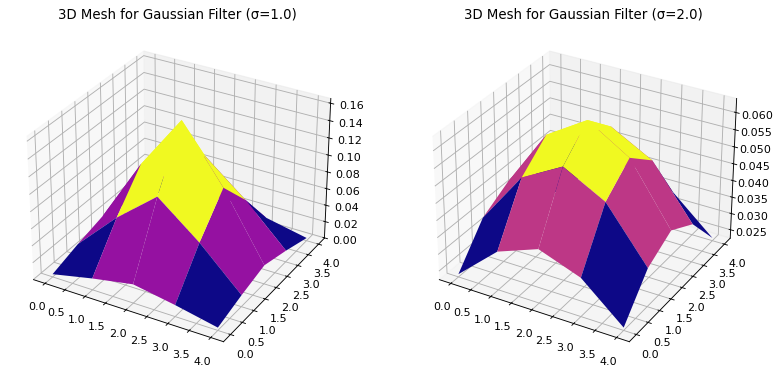

In [15]:
# Plotting of the gaussian filters as "3D meshes"
fig = plt.figure(figsize = (12, 6))
x,y = np.meshgrid(range(5), range(5))

# First subplot (σ=1.0)
ax1 = fig.add_subplot(1, 2, 1, projection = "3d")
ax1.set_title("3D Mesh for Gaussian Filter (σ=1.0)")
ax1.plot_surface(x, y, filter1, cmap = "plasma")

# Second subplot (σ=2.0)
ax2 = fig.add_subplot(1, 2, 2, projection = "3d")
ax2.set_title("3D Mesh for Gaussian Filter (σ=2.0)")
ax2.plot_surface(x, y, filter2, cmap = "plasma")
plt.show()

Observations: The mesh for σ=1.0 looks like a sharp mountain peak, forming a steep needle-like spike that shoots up to 0.16. It drops off rapidly as we move away from the center, where msot of the mass is concentrated in the inner 3x3 region. In comparison for σ=2.0, we get a gentler hill forming a broad and more rounded dome with a lower peak, with much gradual slopes extending across the entire 5x5 area.

In image filtering, this means that after convolution,
For σ=1.0: The underlying output pixel is heavily influenced by the center pixel with 16% weight. It aims to keep the pixel mostly as is, jsut with some slight average with surrounding pixels.

For σ2.0: The output pixels would just be a weighted average of the entire 5x5 region, with center pixel having just a tiny bit more weight. As a result, this creates stronger smoothing - mostly resulting in blurrier looking images.

### Part B - Loading Image with Applied Gaussian Noise

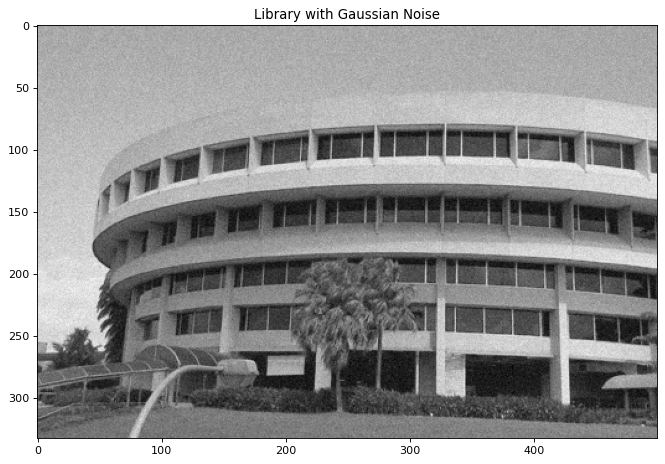

Library with Gaussian Noise Information:
Property             Value     
               Shape (333, 500)
           Data Type      uint8
        Total Pixels    166,500
          Dimensions          2
Memory Usage (bytes)    166,500
     Min Pixel Value          0
     Max Pixel Value        255
    Mean Pixel Value     131.83
  Standard Deviation      58.00


In [16]:
image_with_gaussian_noise = load_image("../assets/lib-gn.jpg")
display_image(image_with_gaussian_noise, title = "Library with Gaussian Noise")
print_image_info(image_with_gaussian_noise, "Library with Gaussian Noise")

### Part C - Image Filtering using the Created Gaussian Filters

scipy provides functions for convolving 2d: https://docs.scipy.org/doc/scipy/reference/generated/scipy.signal.convolve2d.html

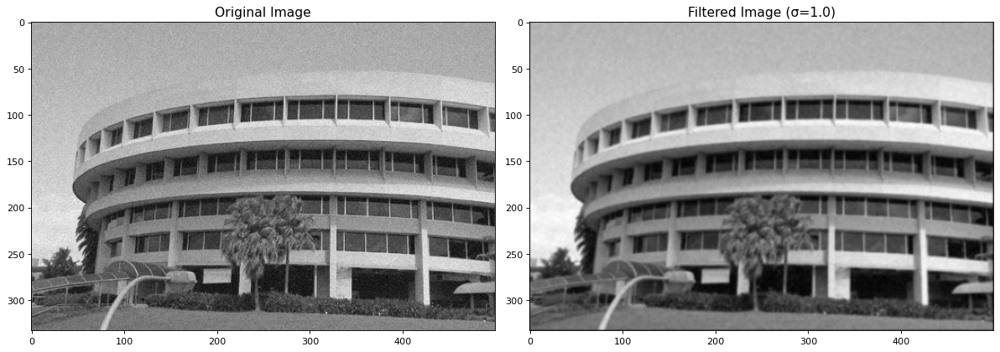

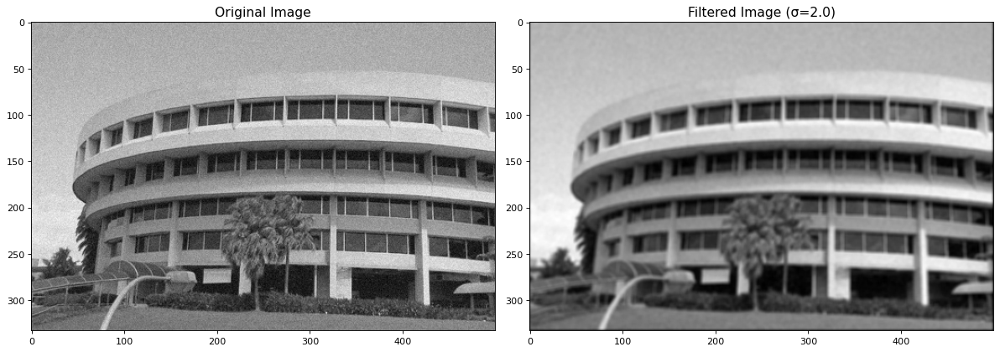

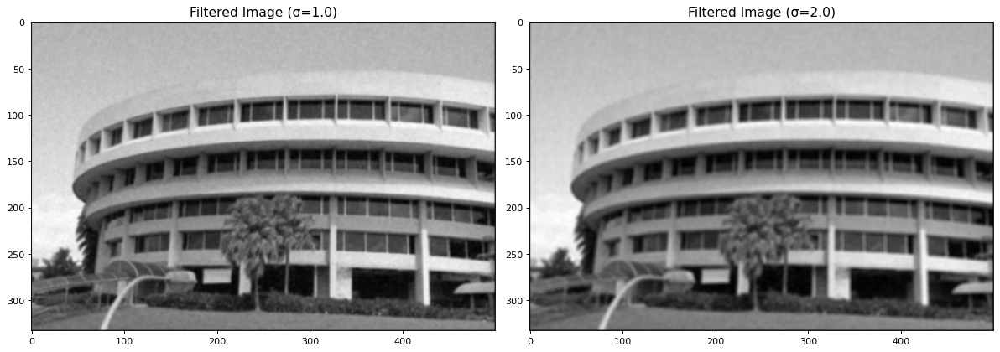

Filtered Image (σ=1.0) Information:
Property             Value     
               Shape (333, 500)
           Data Type    float64
        Total Pixels    166,500
          Dimensions          2
Memory Usage (bytes)  1,332,000
     Min Pixel Value  17.833869
     Max Pixel Value  233.53391
    Mean Pixel Value     131.30
  Standard Deviation      55.54
Filtered Image (σ=2.0) Information:
Property             Value      
               Shape  (333, 500)
           Data Type     float64
        Total Pixels     166,500
          Dimensions           2
Memory Usage (bytes)   1,332,000
     Min Pixel Value    21.45095
     Max Pixel Value  231.225561
    Mean Pixel Value      131.04
  Standard Deviation       54.78


In [17]:
# Recreate the filters to ensure nothing was changed accidentally in previous cells
filter1 = gaussian_filter(5, 1.0)
filter2 = gaussian_filter(5, 2.0)

filtered_image_1 = scipy.signal.convolve2d(image_with_gaussian_noise, filter1, mode = "same")
filtered_image_2 = scipy.signal.convolve2d(image_with_gaussian_noise, filter2, mode = "same")

display_images_side_by_side(image_with_gaussian_noise, filtered_image_1, title1 = "Original Image", title2 = "Filtered Image (σ=1.0)")
display_images_side_by_side(image_with_gaussian_noise, filtered_image_2, title1 = "Original Image", title2 = "Filtered Image (σ=2.0)")
display_images_side_by_side(filtered_image_1, filtered_image_2, title1 = "Filtered Image (σ=1.0)", title2 = "Filtered Image (σ=2.0)")

print_image_info(filtered_image_1, "Filtered Image (σ=1.0)")
print_image_info(filtered_image_2, "Filtered Image (σ=2.0)")


In the original image, we observe it contains some noise (grainy textures, especially visible in the sky area), while fine details are preserved (window frames, tree leaves, etc)

**How effective are the filters in removing noise?**

After filtering with the two filters:

σ = 1.0: A mild smoothing was applied to the image, reducing the noise while keeping most of the details and edges still visible. The image looks slightly softer, which is expected due to the averaging after the convolution. It is rather effective in preserving the details and should be used when prioritising detail preservation over complete noise removal, at the cost of some blurriness.

σ = 2.0: A stronger smoothing is applied, and more of the noise is observed to be removed. However, details in the scene like windows and tree-leaves are softer and blurrier. The entire image looks blurrier due to stronger averaging of the surrounding pixels with itself. This is effective when noise removal is a priority over detail preservation, at the cost of even more blurriness.


**What are the trade-offs between using either of the two filters, or not filtering the image at all?**

The filter with σ = 1.0 preserves more of the details of the images while not completing removing noise, while the filter with σ = 2.0 removes more noise at the cost of the loss of some details. If we do not filter, the noise is still present in the image, which reduces the visibility, but the original image's sharpness is preserved. Overall, it depends on our choice. If we want to:
1. Remove more noise: Use a filter with higher σ at the cost of blurrier images.
2. Keep more details and remove some noise: Use a filter with moderate σ like 1.0 to find the balance.

It is generally up to what the user wants to achieve with the filtering, and whether the prioritization is detail preservation or noise reduction.

### Part D - Loading image with Additive Speckle Noise

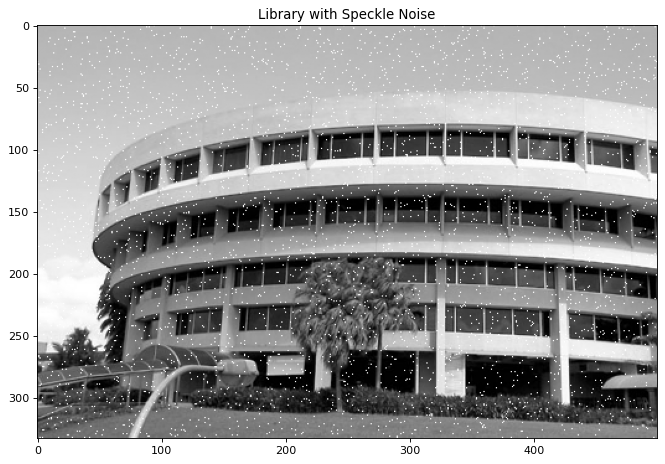

In [18]:
image_with_speckle_noise = load_image("../assets/lib-sp.jpg")
display_image(image_with_speckle_noise, title = "Library with Speckle Noise")

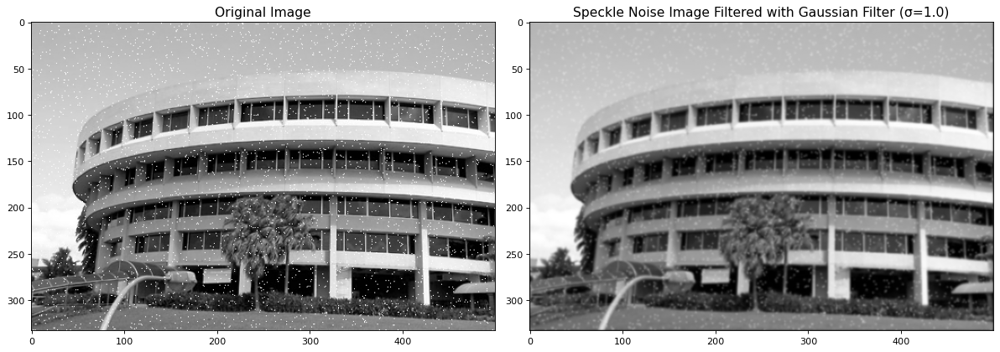

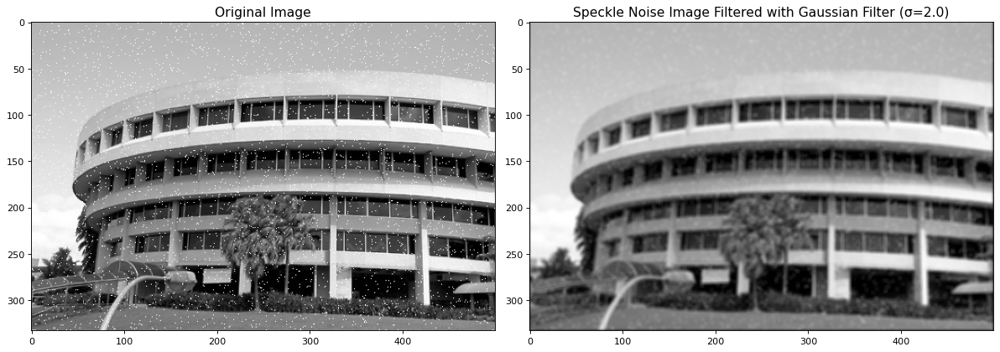

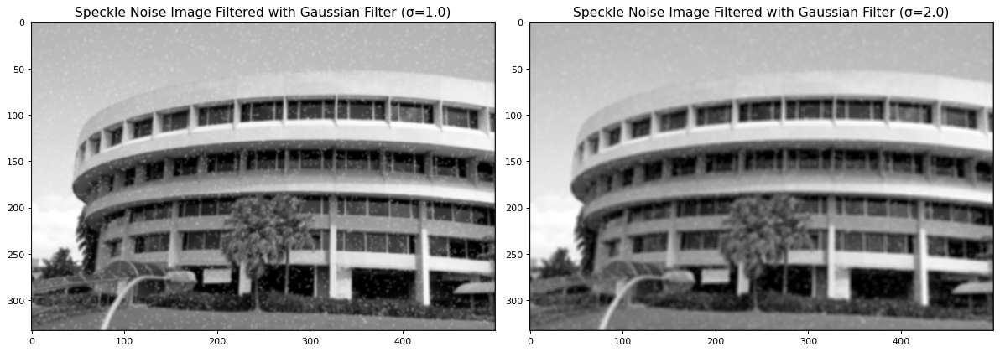

In [19]:
# Recreate the filters to ensure nothing was changed accidentally in previous cells
filter1 = gaussian_filter(5, 1.0)
filter2 = gaussian_filter(5, 2.0)

filtered_speckle_image_1 = scipy.signal.convolve2d(image_with_speckle_noise, filter1, mode = "same")
filtered_speckle_image_2 = scipy.signal.convolve2d(image_with_speckle_noise, filter2, mode = "same")

display_images_side_by_side(image_with_speckle_noise, filtered_speckle_image_1, title1 = "Original Image", title2 = "Speckle Noise Image Filtered with Gaussian Filter (σ=1.0)")
display_images_side_by_side(image_with_speckle_noise, filtered_speckle_image_2, title1 = "Original Image", title2 = "Speckle Noise Image Filtered with Gaussian Filter (σ=2.0)")
display_images_side_by_side(filtered_speckle_image_1, filtered_speckle_image_2, title1 = "Speckle Noise Image Filtered with Gaussian Filter (σ=1.0)", title2 = "Speckle Noise Image Filtered with Gaussian Filter (σ=2.0)")

In the original image, we observe it contains some noise (grainy textures, especially visible in the sky area), while fine details are preserved (window frames, tree leaves, etc)

**How effective are the filters in removing noise?**

After filtering with the two filters:

σ = 1.0: A mild smoothing was applied to the image, reducing the noise while keeping most of the details and edges still visible. The image looks slightly softer, which is expected due to the averaging after the convolution. The filter is less effective in removing Speckle noise, as Gaussian filters do not typically handle these kind of noise.

σ = 2.0: A stronger smoothing is applied, and more of the noise is observed to be removed. However, details in the scene like windows and tree-leaves are softer and blurrier. The entire image looks blurrier due to stronger averaging of the surrounding pixels with itself. Seems abit more effective, but noise can still be seen, as it is not Gaussian noise.


**What are the trade-offs between using either of the two filters, or not filtering the image at all?**

Same conclusion as Part C - just because Gaussian filters are not optimal and meant to reduce speckle noise.

---
## 1.4 Median Filtering
Median filtering is a special case of order-statistic filtering. For each pixel, the set of intensities of neighbouring pixels (in a neighbourhood of specified size) are ordered. Median filtering involves replacing the target pixel with the median pixel intensity. Repeat steps (b) to (e) except we are using median filters of different sizes of 3x3 and 5x5.

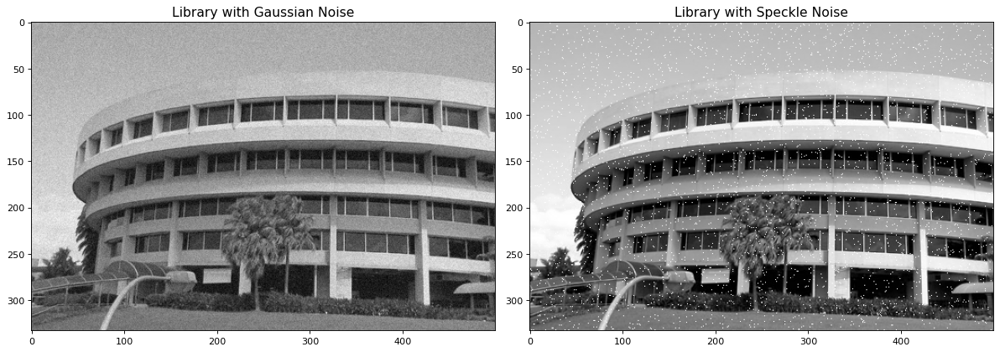

In [20]:
# Reload the images
image_with_gaussian_noise = load_image("../assets/lib-gn.jpg")
image_with_speckle_noise = load_image("../assets/lib-sp.jpg")
display_images_side_by_side(image_with_gaussian_noise, image_with_speckle_noise, title1 = "Library with Gaussian Noise", title2 = "Library with Speckle Noise")

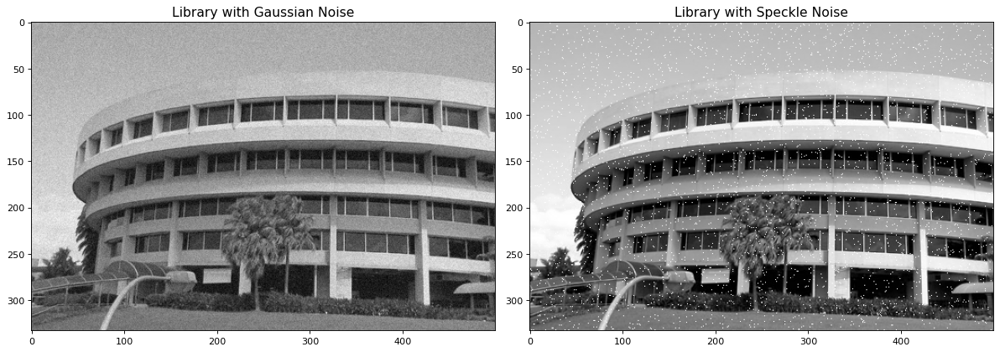

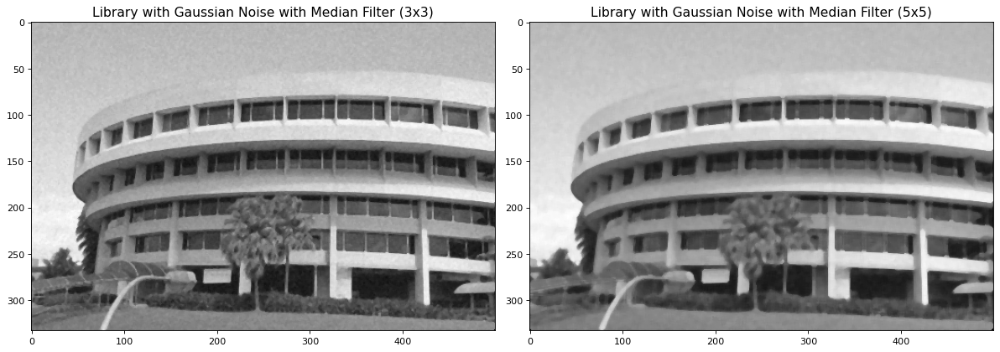

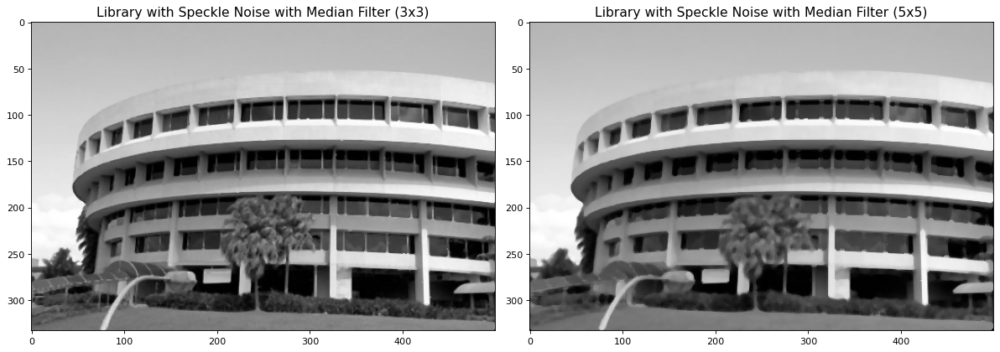

In [21]:
# Create median filters using scipy
median_filter_gaussian_3x3 = scipy.signal.medfilt2d(image_with_gaussian_noise, kernel_size = 3)
median_filter_gaussian_5x5 = scipy.signal.medfilt2d(image_with_gaussian_noise, kernel_size = 5)
median_filter_speckle_3x3 = scipy.signal.medfilt2d(image_with_speckle_noise, kernel_size = 3)
median_filter_speckle_5x5 = scipy.signal.medfilt2d(image_with_speckle_noise, kernel_size = 5)

display_images_side_by_side(image_with_gaussian_noise, image_with_speckle_noise, title1 = "Library with Gaussian Noise", title2 = "Library with Speckle Noise")
display_images_side_by_side(median_filter_gaussian_3x3, median_filter_gaussian_5x5, title1 = "Library with Gaussian Noise with Median Filter (3x3)", title2 = "Library with Gaussian Noise with Median Filter (5x5)")
display_images_side_by_side(median_filter_speckle_3x3, median_filter_speckle_5x5, title1 = "Library with Speckle Noise with Median Filter (3x3)", title2 = "Library with Speckle Noise with Median Filter (5x5)")

**How does Gaussian filtering compare with median filtering in handling the different types of noise?**

On the image with Gaussian Noise, median filtering seems to be less effective, as median filters are excellent for salt-and-pepper type noise, rather than noise that follows a continuous distribution like Gaussian. Overall, Gaussian filters are still better at removing noise. On the plus side, median filters still preserves the edges and still provides a nice result, just it is not as effective as Gaussian filters for this type of noise.

On the image with Speckle Noise, Median filtering is excellent at noise removal, and the crisp edges seem to be preserved while keeping structural details intact. By taking the median, we effectively reduce the impacts of isolated, high intensity pixels, making it great to deal with speckle noise. It is better than Gaussian filters in this sense.

**What are the tradeoffs?**

Median filtering is excellent for salt and pepper noise like speckle, while preserving the edges and structural details of the image. On the downside, it is less effective on common noise like Gaussian, and providing an even larger blur effect than Gaussian with larger kernels.

Gaussian is the opposite - to put in report.

Overall - isolated noise == median filtering, continunous noise throughout image == gaussian filtering.

---
## 1.5 Suppressing Noise Interference Patterns
Occassionally with poor television reception, parallel lines will be seen on the screen corruputing the desired image. These are interference patterns that lie within the frequency domain. Here, we explore how bandpass filtering can be used to suppress such intereference.

### Part A - Loading of image with Interference Observation

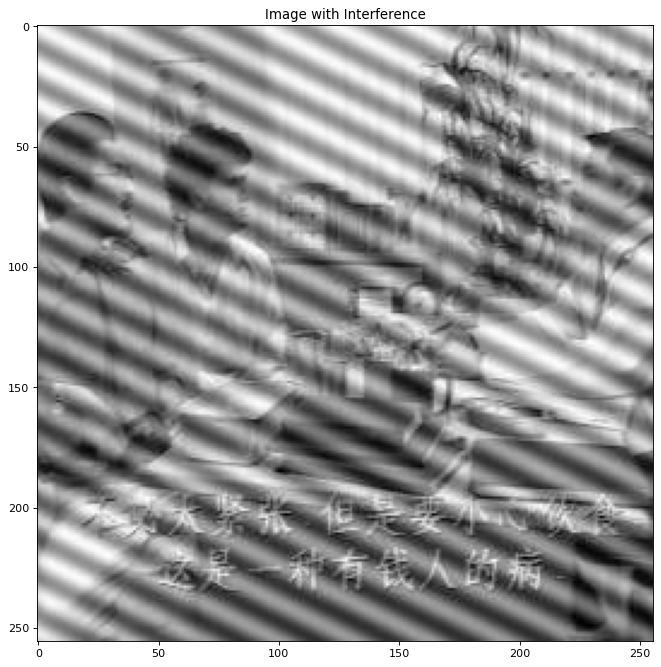

In [22]:
image_with_interference = load_image("../assets/pck-int.jpg")
display_image(image_with_interference, title = "Image with Interference")

In the image, there are multiple diagonal lines spread across the image, making it hard to do processing in the spatial domain to remove such noise. In this case, we have to swap to the frequency domain and remove such noise.

### Part B - Obtaining the Fourier Transform of Image with Intereference

In this section, we obtain the Fourier Transform of the image and compute the power spectrum of the image. F is a matrix of complex values, and S is a real matrix. Display the power spectrum by 

>> imagesc(fftshift(S.^0.1))

>> colormap ('default)

In numpy, fft is already provided, and we can use the fft module to get access to fft2.

In [23]:
def show_power_spectrum(image, do_shifting = True):
    # Calculate the fourier transform of the image
    F = np.fft.fft2(image)
    # Compute the power spectrum
    S = np.abs(F)**2
     # Shift the zero frequency component to the center of the spectrum
    S_shifted = np.fft.fftshift(S ** 0.1) if do_shifting else S ** 0.1
    # Handle the plotting
    plt.figure(figsize = (10, 8))
    plt.imshow(S_shifted)
    plt.colorbar()
    plt.show()

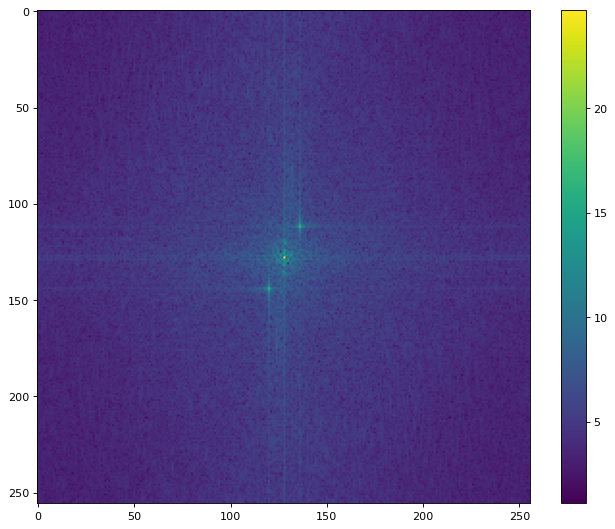

In [24]:
# Following the variable naming in lab manual
show_power_spectrum(image_with_interference)

**General Observations**:
1. The center of the image is the DC component, shown by the bright green dot in the middle. It also represents the average brightness of the image, and is always the brightest point in the power spectrum. Due to fftshift, it is in the middle of the image.

2. We also observe two symmetric peaks. and this tells us important details of the image:
- The image contains a **periodic/repetitive** pattern
- This pattern appears at some **specific frequency and direction**
- It also symmetric due to the fundamental property that Fourier transforms of real images are conjugate symmetric. F(u,v) = F*(-u,-v).

Based on how far it is from the peak, the further away it is from the center, the higher the frequency (causing fine and dense patterns), while close to center means low frequency (with coarse and sparse patterns). We observe the two peaks also form a diagonal line in the frequency domain, which indicates the presence of diagonal stripes at that specific frequency in the spatial domain. The positions of the peak tell us both the frequency (the spacing between stripes) and the orientation (diagonal) of the interference pattern.

### Part C - Display Power Spectrum without fftshift.

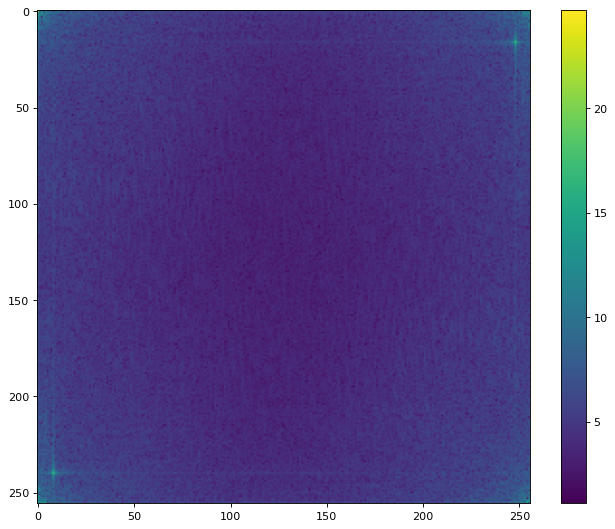

In [25]:
show_power_spectrum(image_with_interference, do_shifting = False)

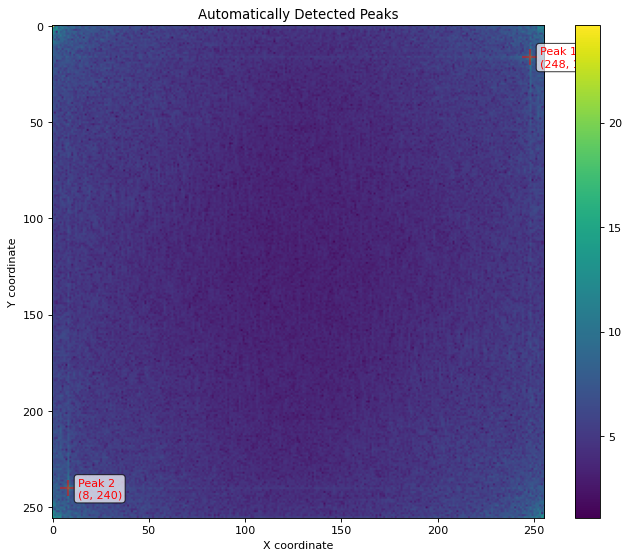


Detected Peak Coordinates:
Peak 1: x=248, y=16 | Distance from center: 164.15
Peak 2: x=8, y=240 | Distance from center: 164.15


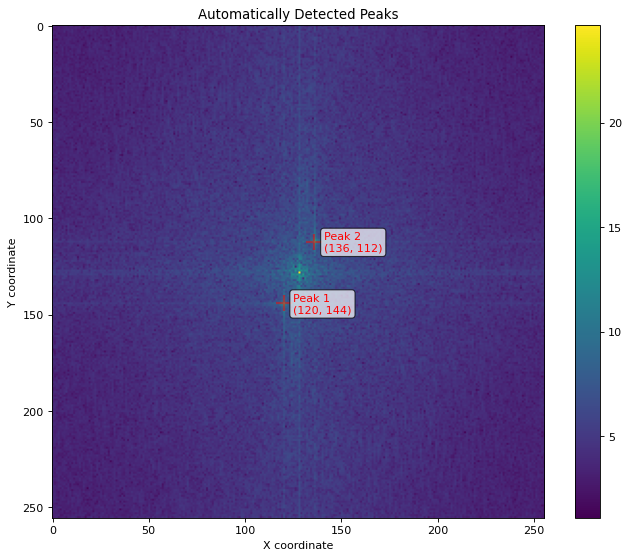


Detected Peak Coordinates:
Peak 1: x=120, y=144 | Distance from center: 17.89
Peak 2: x=136, y=112 | Distance from center: 17.89


In [26]:
def find_peaks_in_power_spectrum(image, num_peaks=3, do_shifting = False, ignore_dc = True):
    # Compute power spectrum
    F = np.fft.fft2(image)
    S = np.abs(F) ** 2
    S_shifted = np.fft.fftshift(S ** 0.1) if do_shifting else S ** 0.1
    
    # Find local maxima
    # Apply maximum filter to find local peaks
    local_max = scipy.ndimage.maximum_filter(S_shifted, size=20) == S_shifted
    
    # Get peak locations
    peak_coords = np.argwhere(local_max)
    peak_values = S_shifted[local_max]
    
    # Sort by intensity and get top N peaks
    # Ignore dc as its the brightest if enabled
    sorted_indices = np.argsort(peak_values)[::-1] if not ignore_dc else np.argsort(peak_values)[::-1][1:]
    top_peaks = peak_coords[sorted_indices[:num_peaks]]
    
    # Visualize
    plt.figure(figsize=(10, 8))
    plt.imshow(S_shifted)
    plt.colorbar()
    plt.title('Automatically Detected Peaks')
    
    # Plot peaks
    for i, (y, x) in enumerate(top_peaks):
        plt.plot(x, y, 'r+', markersize=15, markeredgewidth=2, alpha = 0.5)
        plt.text(x+5, y+5, f'Peak {i+1}\n({x}, {y})', 
                 color='red', fontsize=10, bbox=dict(boxstyle='round', 
                 facecolor='white', alpha=0.7))
    
    plt.xlabel('X coordinate')
    plt.ylabel('Y coordinate')
    plt.show()
    
    # Print results
    print("\nDetected Peak Coordinates:")
    center_y, center_x = image.shape[0]//2, image.shape[1]//2
    
    for i, (y, x) in enumerate(top_peaks):
        # Just ca lculate some Euclidean distance
        distance = np.sqrt((x - center_x)**2 + (y - center_y)**2)
        print(f"Peak {i+1}: x={x}, y={y} | Distance from center: {distance:.2f}")
    
    return top_peaks

# Usage
peaks = find_peaks_in_power_spectrum(image_with_interference, num_peaks=2)
peaks = find_peaks_in_power_spectrum(image_with_interference, num_peaks=2, do_shifting = True)

### Part D - Zero-ing out Neighbour Elements at Identified Peaks

Set to zero the 5x5 neighbour elements at locations corresponding to the above peaks in the Fourier transform F, not the power spectrum. Then recompute the power spectrum and display it as in step (b). This is an example of a notch filter.

In [27]:
def apply_notch_filter(image, peak_coords, do_shifting = False, neighbourhood_size = 5, zero_cross = False, line_length=None, line_thickness=1):
    """
    This function just applies a notch filter b yzeroing out neighbourhoods around the coordinates, in this case peaks
    Parameters:
        image: The image to apply the notch filter to
        peak_coords: The coordinates of the peaks in the power spectrum
        do_shifting: Whether to shift the zero frequency component to the center of the spectrum
        neighbourhood_size: The size of the neighbourhood to zero out
        zero_cross: Whether to zero out the lines crossing the peaks
        line_length: The length of the line to zero out
        line_thickness: The thickness of the line to zero out
    """
    # Computer the Fourier Transform
    F = np.fft.fft2(image)

    # Create a copy to keep original for comparison
    F_filtered = F.copy()

    # Handle coordinate transformation if shifting is used 
    height, width = image.shape
    center_y, center_x = image.shape[0]//2, image.shape[1]//2

    # Claculate half sizes for neighbourhood and lines
    half_size = neighbourhood_size // 2
    half_thickness = line_thickness // 2
    if line_length is None: # Default line length is full image
        line_length = max(height, width) * 2
    half_length = line_length // 2

    # Debug information
    print(f"Do shifting: {do_shifting}")
    print(f"Running notch filter with {neighbourhood_size}x{neighbourhood_size} zeroing.")
    if zero_cross:
        print(f"Cross lines: length={line_length}px, thickness={line_thickness}px")

    if do_shifting:
        F_filtered = np.fft.fftshift(F_filtered)
        print("Working in shifted coordinate space")

    # Process each peak - coordinates are now in the correct space
    for i, (y_peak, x_peak) in enumerate(peak_coords):
        print(f"\nPeak {i+1}: ({x_peak}, {y_peak})")
        
        # Zero out the neighbourhooda round this peak
        y_min = max(0, y_peak - half_size)
        y_max = min(height, y_peak + half_size + 1)
        x_min = max(0, x_peak - half_size)
        x_max = min(width, x_peak + half_size + 1)
        
        F_filtered[y_min:y_max, x_min:x_max] = 0
        print(f"  Neighborhood: rows [{y_min}:{y_max}], cols [{x_min}:{x_max}]")
        
        # Optionally, also zero out the cross pattern
        if zero_cross:
            # Horizontal line (fixed row, varying columns)
            y_h_min = max(0, y_peak - half_thickness)
            y_h_max = min(height, y_peak + half_thickness + 1)
            x_h_min = max(0, x_peak - half_length)
            x_h_max = min(width, x_peak + half_length + 1)
            F_filtered[y_h_min:y_h_max, x_h_min:x_h_max] = 0
            
            # Vertical line (varying rows, fixed column)
            y_v_min = max(0, y_peak - half_length)
            y_v_max = min(height, y_peak + half_length + 1)
            x_v_min = max(0, x_peak - half_thickness)
            x_v_max = min(width, x_peak + half_thickness + 1)
            F_filtered[y_v_min:y_v_max, x_v_min:x_v_max] = 0
            
            print(f"  Horizontal line: rows [{y_h_min}:{y_h_max}], cols [{x_h_min}:{x_h_max}]")
            print(f"  Vertical line: rows [{y_v_min}:{y_v_max}], cols [{x_v_min}:{x_v_max}]")
    
    # If we shifted F for filtering, shift it back to original space
    if do_shifting:
        F_filtered = np.fft.ifftshift(F_filtered)
        print("\nShifted F back to original space for reconstruction")
    
    # Now we can compute the power spectrum of the filtered Fourier Transform
    S_filtered = np.abs(F_filtered)**2
    # Shift display if necessary
    S_filtered_display = np.fft.fftshift(S_filtered ** 0.1) if do_shifting else S_filtered ** 0.1

    # Also compute original for comparison
    S_original = np.abs(F)**2
    S_original_display = np.fft.fftshift(S_original ** 0.1) if do_shifting else S_original ** 0.1

    # Display results
    fig, axes = plt.subplots(1, 3, figsize = (15, 5))
    axes[0].imshow(S_original_display)
    axes[0].set_title("Original Power Spectrum")
    axes[1].imshow(S_filtered_display)
    axes[1].set_title("Filtered Power Spectrum")
    axes[2].imshow(S_original_display - S_filtered_display)
    axes[2].set_title("Difference")
    plt.tight_layout()
    plt.show()
    return F_filtered, S_filtered_display, S_original_display

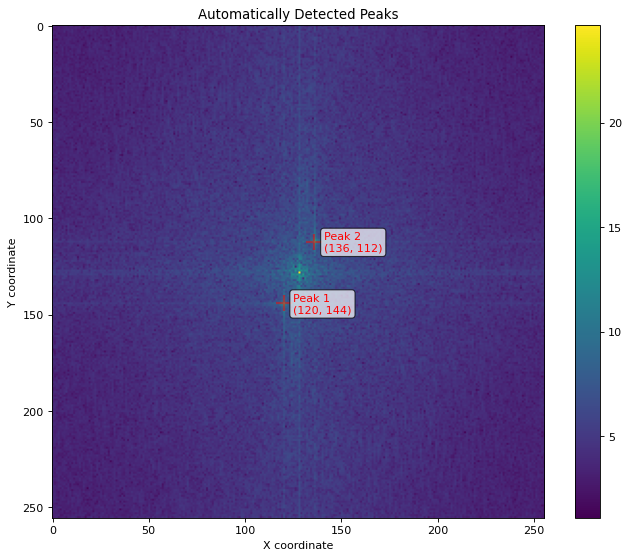


Detected Peak Coordinates:
Peak 1: x=120, y=144 | Distance from center: 17.89
Peak 2: x=136, y=112 | Distance from center: 17.89
Do shifting: True
Running notch filter with 5x5 zeroing.
Working in shifted coordinate space

Peak 1: (120, 144)
  Neighborhood: rows [142:147], cols [118:123]

Peak 2: (136, 112)
  Neighborhood: rows [110:115], cols [134:139]

Shifted F back to original space for reconstruction


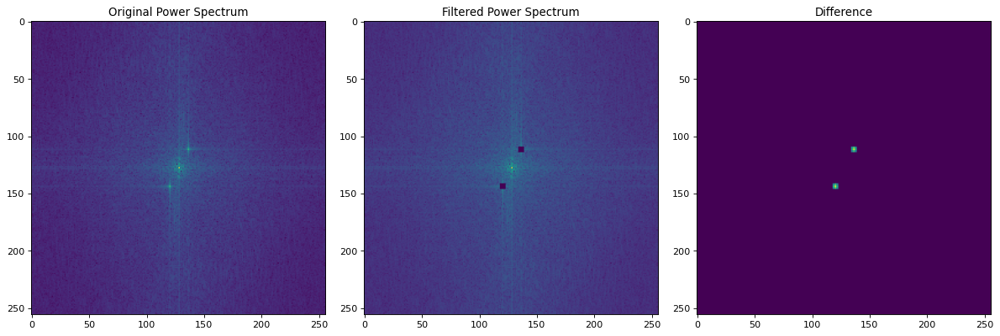

In [28]:
# Use our initial peak function to find the peaks
do_shifting = True
peaks = find_peaks_in_power_spectrum(image_with_interference,
    num_peaks=2, # 2 as from visual inspection, there are 2 peaks 
    do_shifting = do_shifting,
    ignore_dc = True)
# Apply notch filter
F_filtered, S_filtered_display, S_original_display = apply_notch_filter(image_with_interference, 
    peaks,
    do_shifting = do_shifting, 
    neighbourhood_size=5)

### Part E - Performing Inverse Fourier Transform to Reconstruct Image with Interference

In this section, we compute the inverse fourier transform using ifft2 and display the resultant image.

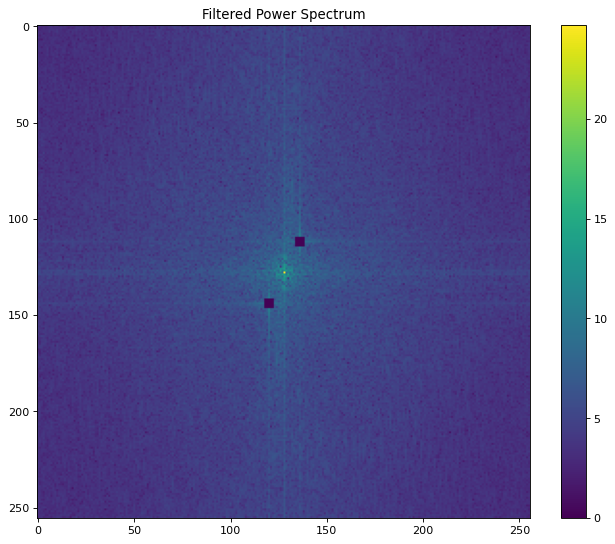

In [29]:
# Using the variables found in Part E, we have S_filtered_display.
# Show the filtered power spectrum
plt.figure(figsize = (10, 8))
plt.imshow(S_filtered_display)
plt.colorbar()
plt.title("Filtered Power Spectrum")
plt.show()

In [30]:
def inverse_fourier_transform(F):
    # Then use inverse fourier transform to reconstruct the image
    inverseft = np.fft.ifft2(F)
    # Convert back to uint8
    image_reconstructed = np.abs(inverseft).astype(np.uint8)
    return inverseft, image_reconstructed

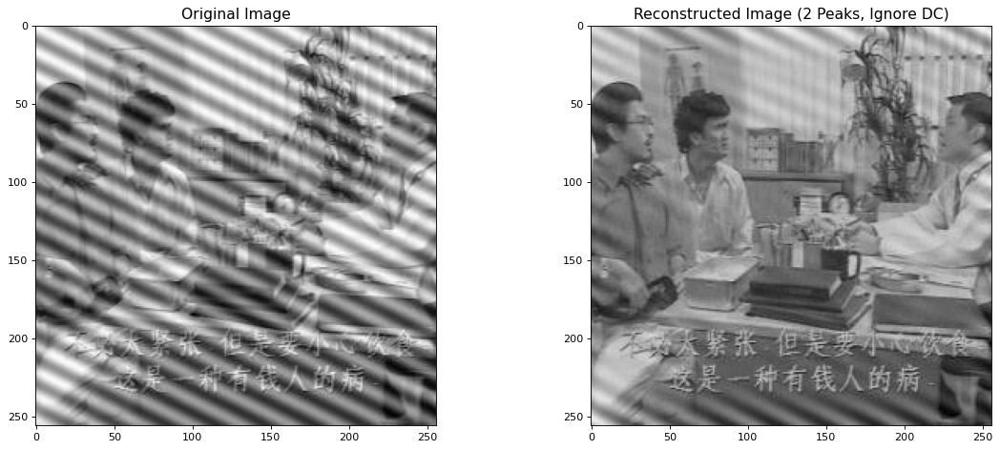

In [31]:
inversef, image_reconstructed = inverse_fourier_transform(F_filtered)
display_images_side_by_side(image_with_interference, image_reconstructed, title1 = "Original Image", title2 = "Reconstructed Image (2 Peaks, Ignore DC)")

**Observation**

Setting the neighbouring pixels around the peaks to 0 actually helped to reduce alot of the noise. It is clearer in the right view that there are people sitting at a table, with background details and the room structure. In this case, it may be acceptable for some to use this image as is for its intended purpose. The chinese text is also now legible and clear. This shows how Fourier Transform is powerful, especially if the image to be recoevered was for historical purposes. However, it may be possible that the image may appear less sharp than it would be without intereference. Some fine details may be smoothed out as legitimate high-frequency content may have overlapped with the interference frequencies, which is unavoidable loss.

Do shifting: True
Running notch filter with 15x15 zeroing.
Working in shifted coordinate space

Peak 1: (120, 144)
  Neighborhood: rows [137:152], cols [113:128]

Peak 2: (136, 112)
  Neighborhood: rows [105:120], cols [129:144]

Shifted F back to original space for reconstruction


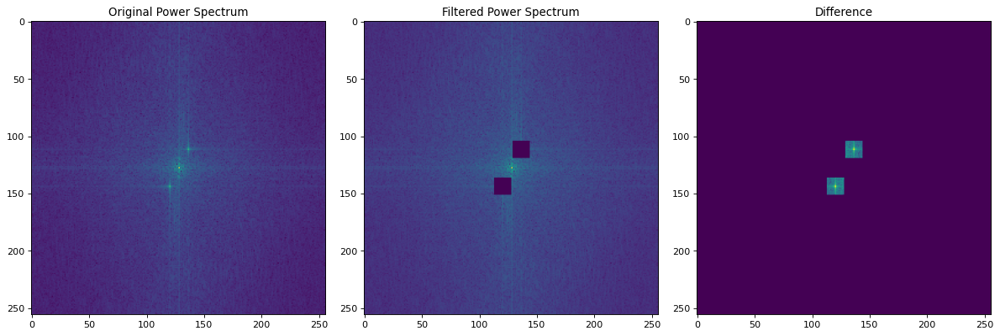

In [32]:
# Try to further improve the result, on closer inspection, it seems that around the peaks, 5x5 may not be enough.
# Apply notch filter
F_filtered_15, S_filtered_display_15, S_original_display_15 = apply_notch_filter(image_with_interference, 
    peaks,
    do_shifting = True, # Change this to see other view
    neighbourhood_size=15)

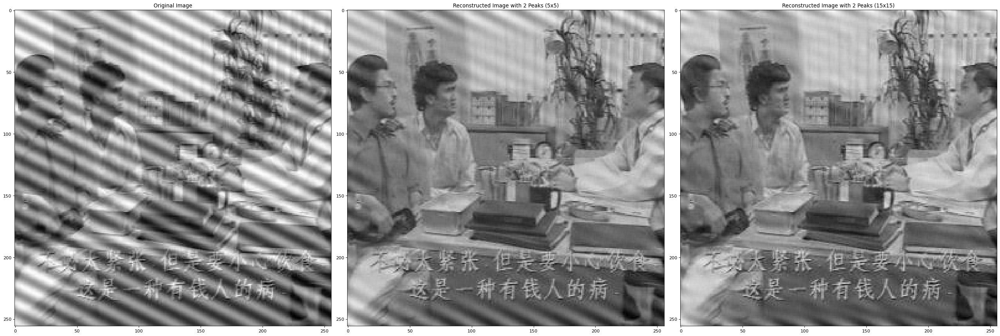

In [33]:
# Then use inverse fourier transform to reconstruct the image
inverseft, image_reconstructed_15 = inverse_fourier_transform(F_filtered_15)

fig, axes = plt.subplots(1, 3, figsize = (32, 16))
axes[0].imshow(image_with_interference, cmap = "gray")
axes[0].set_title("Original Image")
axes[1].imshow(image_reconstructed, cmap = "gray")
axes[1].set_title("Reconstructed Image with 2 Peaks (5x5)")
axes[2].imshow(image_reconstructed_15, cmap = "gray")
axes[2].set_title("Reconstructed Image with 2 Peaks (15x15)")
plt.tight_layout()
plt.show()


From analysis, in the original power spectrum, there are visible white lines that span across the peaks. We can also try to zero them out along those lines, to reduce the noise on the reconstructed image.

Do shifting: True
Running notch filter with 5x5 zeroing.
Cross lines: length=512px, thickness=1px
Working in shifted coordinate space

Peak 1: (120, 144)
  Neighborhood: rows [142:147], cols [118:123]
  Horizontal line: rows [144:145], cols [0:256]
  Vertical line: rows [0:256], cols [120:121]

Peak 2: (136, 112)
  Neighborhood: rows [110:115], cols [134:139]
  Horizontal line: rows [112:113], cols [0:256]
  Vertical line: rows [0:256], cols [136:137]

Shifted F back to original space for reconstruction


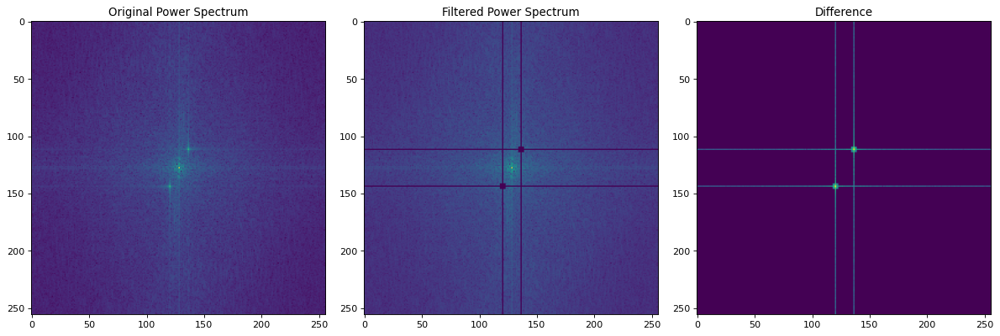

In [34]:
# Try to further improve the result, on closer inspection, also cross out the lines that span across the peaks
# Apply notch filter
F_filtered_cross, S_filtered_display_cross, S_original_display_cross = apply_notch_filter(image_with_interference, 
    peaks,
    do_shifting = True, # Change this to see other view 
    neighbourhood_size=5,
    zero_cross=True)

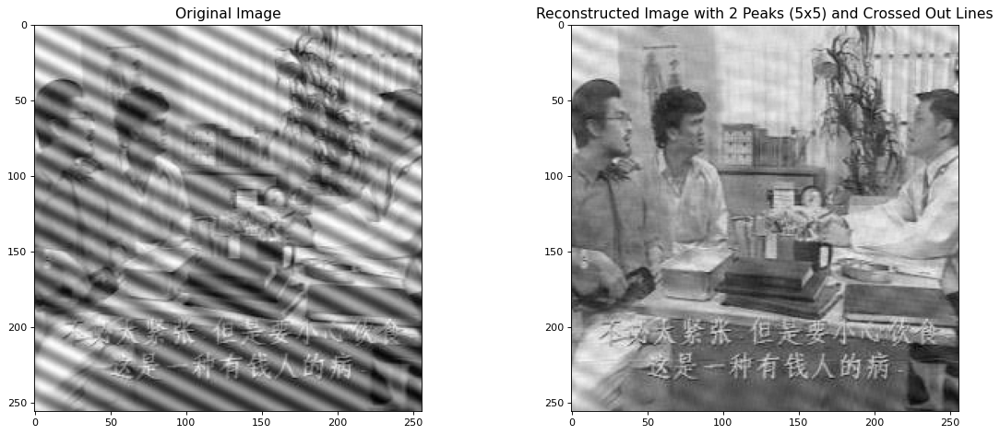

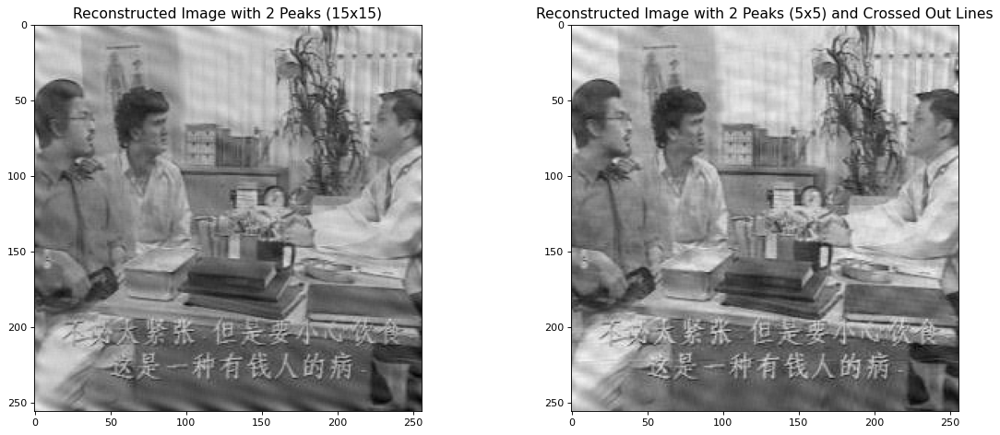

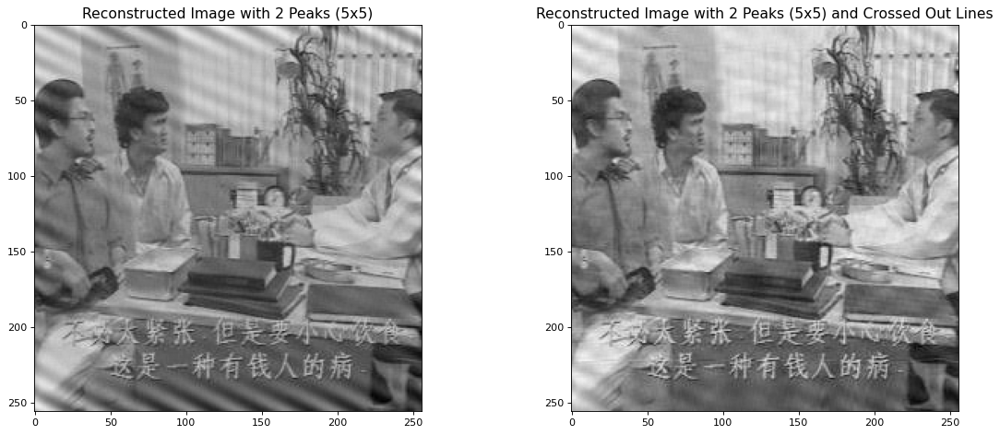

In [35]:
inverseft, image_reconstructed_cross = inverse_fourier_transform(F_filtered_cross)
display_images_side_by_side(image_with_interference, image_reconstructed_cross, title1 = "Original Image", title2 = "Reconstructed Image with 2 Peaks (5x5) and Crossed Out Lines")
# Comparison against large neighbourhood size and small neighbour hood size with crossed outd
display_images_side_by_side(image_reconstructed_15, image_reconstructed_cross, title1 = "Reconstructed Image with 2 Peaks (15x15)", title2 = "Reconstructed Image with 2 Peaks (5x5) and Crossed Out Lines")
display_images_side_by_side(image_reconstructed, image_reconstructed_cross, title1 = "Reconstructed Image with 2 Peaks (5x5)", title2 = "Reconstructed Image with 2 Peaks (5x5) and Crossed Out Lines")

Do shifting: True
Running notch filter with 10x10 zeroing.
Cross lines: length=512px, thickness=1px
Working in shifted coordinate space

Peak 1: (120, 144)
  Neighborhood: rows [139:150], cols [115:126]
  Horizontal line: rows [144:145], cols [0:256]
  Vertical line: rows [0:256], cols [120:121]

Peak 2: (136, 112)
  Neighborhood: rows [107:118], cols [131:142]
  Horizontal line: rows [112:113], cols [0:256]
  Vertical line: rows [0:256], cols [136:137]

Shifted F back to original space for reconstruction


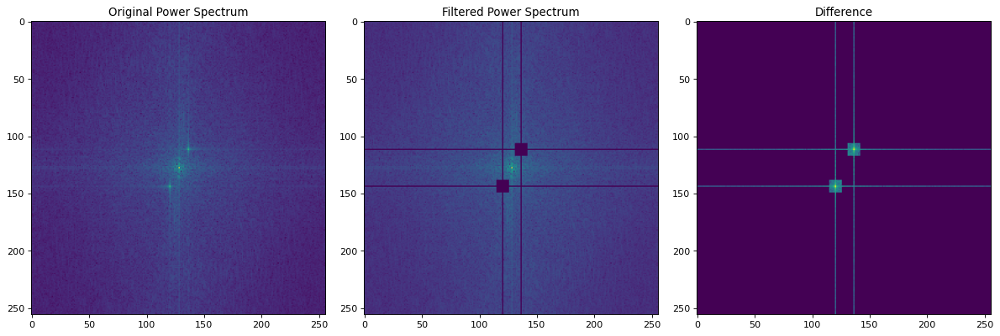

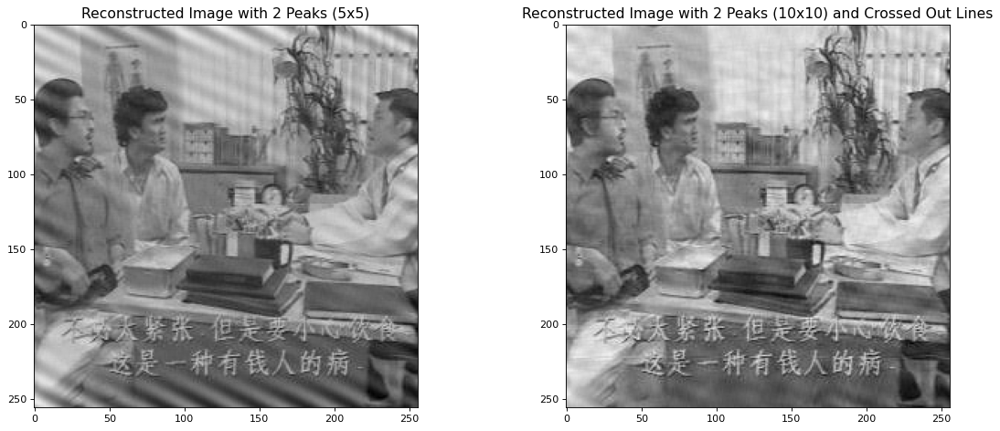

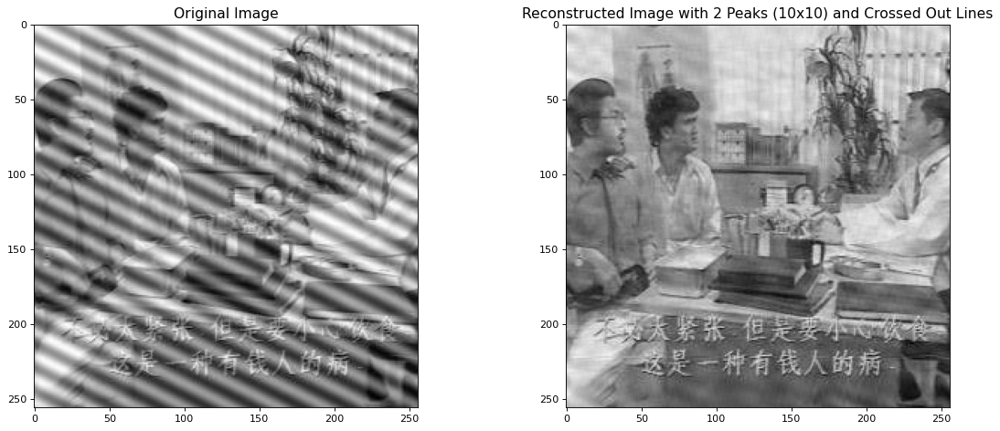

In [36]:
# Feature Ablation, Larger neighbour size with cross out lines
F_filtered_cross_large, S_filtered_display_cross_large, S_original_display_cross_large = apply_notch_filter(image_with_interference, 
    peaks,
    do_shifting = True, # Change this to see other view 
    neighbourhood_size=10,
    zero_cross=True)
inverseft, image_reconstructed_cross_large = inverse_fourier_transform(F_filtered_cross_large)
display_images_side_by_side(image_reconstructed, image_reconstructed_cross_large, title1 = "Reconstructed Image with 2 Peaks (5x5)", title2 = "Reconstructed Image with 2 Peaks (10x10) and Crossed Out Lines")
display_images_side_by_side(image_with_interference, image_reconstructed_cross_large, title1 = "Original Image", title2 = "Reconstructed Image with 2 Peaks (10x10) and Crossed Out Lines")

**Observation**

Using visual analysis from the power spectrum map, we also identify that the high intensity lines created at the peak also influences the output of the image. Once we have removed those particular noise in the image with our newly updated result using neighbourhood size = 10 and cross out lines, we get a nice clean image seen above at the cost of some blurriness. However, we have successfully managed to remove majority of the noise, which is a huge upside from the original image we had.

### Part F - Freeing the Primate by Filtering out the Fence.

From the image which shows a primate behind a fence, we attempt to "free" the primate by filtering out the fence

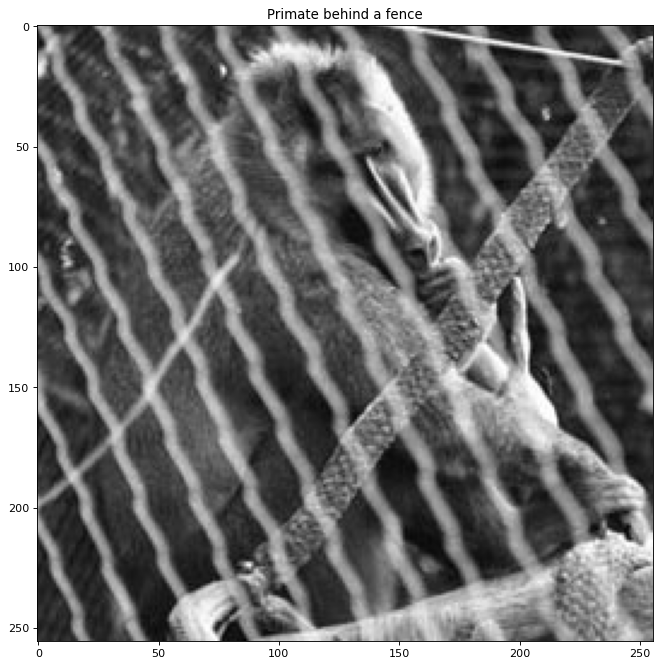

Image Information:
Property             Value     
               Shape (256, 256)
           Data Type      uint8
        Total Pixels     65,536
          Dimensions          2
Memory Usage (bytes)     65,536
     Min Pixel Value         10
     Max Pixel Value        255
    Mean Pixel Value     106.68
  Standard Deviation      53.58


In [37]:
primate_image = load_image("../assets/primate-caged.jpg")
display_image(primate_image, title = "Primate behind a fence")
print_image_info(primate_image)

The fence can be seen as patterns among the image, and we need to access the image's fourier transform to enter the frequency domains, to see how well we are able to remove the fence on the image.

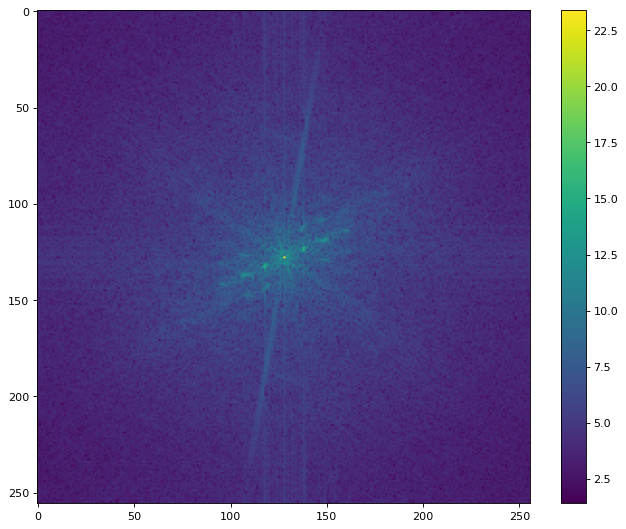

In [38]:
show_power_spectrum(primate_image)

In the power spectrum, we notice a few pixels with high intensity that follows the diagonal pattern we see before. We can see patterns of it repeating down the y-axis, which highly indicate that these intensities belong to the fence itself. Knowing this information, we should be able to find some function to clear those lines in nature, setting them to zero along these lines would mean successful free-ing of the primate in essence.

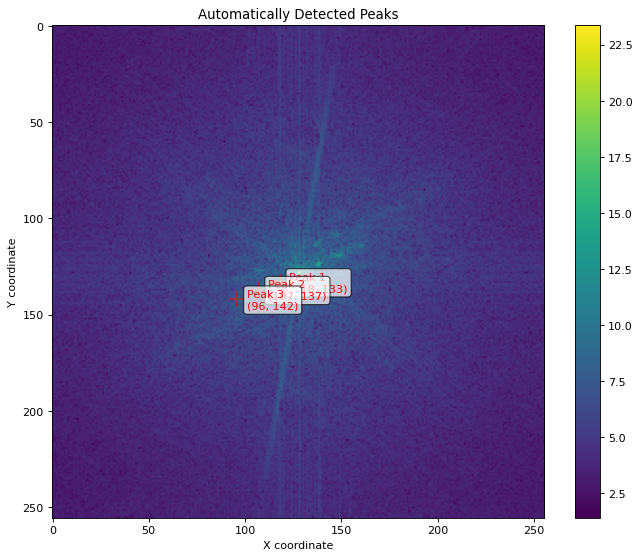


Detected Peak Coordinates:
Peak 1: x=118, y=133 | Distance from center: 11.18
Peak 2: x=107, y=137 | Distance from center: 22.85
Peak 3: x=96, y=142 | Distance from center: 34.93


In [39]:
# Use our initial peak function to find the peaks to see if that helps, 
peaks = find_peaks_in_power_spectrum(primate_image, num_peaks=3, do_shifting = True, ignore_dc = True)

After visualizing the peaks, we realize that these so called bright lines actually sort of form a line, if we can find a line that roughly fits this in the fourier transform, we can repeat those lines with some step in the fourier transform space and clear the fence. This is sort of periodic interference.

In [40]:
def apply_diagonal_notch_filter(image, peak_coords, do_shifting=False, 
                                line_thickness=3, num_harmonics=5, harmonic_spacing=None, 
                                line_length=None, protect_dc=True, dc_radius=10, visualize = True):
    """
    Applies a notch filter by zeroing out diagonal lines through peaks
    AND parallel harmonic lines above/below.
    
    Parameters:
        image: The image to filter
        peak_coords: List of (y, x) peak coordinates 
        do_shifting: Whether coordinates are in shifted space
        line_thickness: Thickness of each line
        num_harmonics: Number of parallel lines to zero on each side
        harmonic_spacing: Distance between parallel lines (auto-calculated if None)
        line_length: Length of the line to zero out (None = full length across spectrum)
        protect_dc: If True, preserve DC component (avoid zeroing near origin)
        dc_radius: Radius around DC component to protect (pixels)
    """
    # Compute Fourier Transform
    F = np.fft.fft2(image)
    F_filtered = F.copy()
    
    height, width = image.shape
    center_y, center_x = height // 2, width // 2
    
    print(f"Image size: {width}x{height}")
    print(f"Spectrum center: ({center_x}, {center_y})")
    print(f"Number of peaks: {len(peak_coords)}")
    print(f"Harmonics to remove: {num_harmonics} on each side")
    print(f"DC protection: {'ON' if protect_dc else 'OFF'} (radius={dc_radius})" if protect_dc else "DC protection: OFF")
    
    # Shift if necessary
    if do_shifting:
        F_filtered = np.fft.fftshift(F_filtered)
        print("Working in shifted coordinate space")
    
    # Calculate line equation using first and last peak
    peak_coords_array = np.array(peak_coords)
    y_coords = peak_coords_array[:, 0]
    x_coords = peak_coords_array[:, 1]
    
    y1, x1 = y_coords[0], x_coords[0]
    y2, x2 = y_coords[-1], x_coords[-1]
    
    print(f"\nPrimary line from ({x1}, {y1}) to ({x2}, {y2})")
    
    # Create coordinate grids
    y_grid, x_grid = np.ogrid[:height, :width]
    
    # Create DC protection mask (circular region around center to preserve) - without this somehow my image became dark as hell like bruh
    if protect_dc:
        distance_from_center = np.sqrt((x_grid - center_x)**2 + (y_grid - center_y)**2)
        dc_mask = distance_from_center <= dc_radius  # True where we should NOT zero
    else:
        dc_mask = np.zeros((height, width), dtype=bool)  # Don't protect anything
    
    # Calculate slope and intercept
    if x2 - x1 == 0:  # Vertical line
        print("Vertical line detected")
        # Auto-calculate spacing if not provided
        if harmonic_spacing is None:
            harmonic_spacing = 10  # Default spacing for vertical lines
        
        # Calculate line center and length
        line_center_y = (y1 + y2) / 2
        if line_length is None:
            line_length = height  # Full height
        half_length = line_length / 2
        
        # Zero out main vertical line and harmonics
        for i in range(-num_harmonics, num_harmonics + 1):
            x_line = x1 + i * harmonic_spacing
            x_min = max(0, int(x_line - line_thickness//2))
            x_max = min(width, int(x_line + line_thickness//2 + 1))
            
            # Limit y-range based on line_length
            y_min = max(0, int(line_center_y - half_length))
            y_max = min(height, int(line_center_y + half_length))
            
            if x_min < width and x_max > 0:
                # Create a region mask and exclude DC area
                region_mask = np.zeros((height, width), dtype=bool)
                region_mask[y_min:y_max, x_min:x_max] = True
                # Only zero pixels NOT in DC region
                F_filtered[region_mask & ~dc_mask] = 0
                if i == 0:
                    num_zeroed = np.sum(region_mask & ~dc_mask)
                    print(f"Main line: columns [{x_min}:{x_max}], rows [{y_min}:{y_max}], {num_zeroed} pixels")
        
    else:
        # Line equation: y = mx + b
        slope = (y2 - y1) / (x2 - x1)
        intercept = y1 - slope * x1
        
        print(f"Line equation: y = {slope:.3f}x + {intercept:.3f}")
        
        # Auto-calculate spacing if not provided
        # Spacing is perpendicular distance between harmonic lines
        if harmonic_spacing is None:
            # Estimate from peak spacing
            if len(peak_coords) >= 2:
                # Distance between consecutive peaks
                distances = []
                for i in range(len(peak_coords)-1):
                    dy = y_coords[i+1] - y_coords[i]
                    dx = x_coords[i+1] - x_coords[i]
                    distances.append(np.sqrt(dx**2 + dy**2))
                harmonic_spacing = np.mean(distances)
            else:
                harmonic_spacing = 20  # Default
        
        print(f"Harmonic spacing: {harmonic_spacing:.1f} pixels")
        
        # Calculate line center and direction
        line_center_x = (x1 + x2) / 2
        line_center_y = (y1 + y2) / 2
        
        # Line direction vector (normalized)
        dx_line = x2 - x1
        dy_line = y2 - y1
        line_length_actual = np.sqrt(dx_line**2 + dy_line**2)
        dir_x = dx_line / line_length_actual  # Unit direction vector
        dir_y = dy_line / line_length_actual
        
        # Perpendicular direction vector
        perp_x = -dy_line / line_length_actual
        perp_y = dx_line / line_length_actual
        
        # Set line length
        if line_length is None:
            line_length = max(height, width) * 2  # Full length across spectrum
        half_length = line_length / 2
        
        print(f"Line length: {line_length:.1f} pixels")
        
        total_zeroed = 0
        
        # Zero out main line and harmonics
        for i in range(-num_harmonics, num_harmonics + 1):
            # Shift intercept by moving perpendicular to the line
            offset = i * harmonic_spacing
            intercept_offset = intercept + offset * np.sqrt(1 + slope**2) * np.sign(perp_y)
            
            # Calculate perpendicular distance to this parallel line
            distance_perp = np.abs(slope * x_grid - y_grid + intercept_offset) / np.sqrt(slope**2 + 1)
            
            # Calculate distance along the line from center
            # Project each point onto the line direction
            dx_from_center = x_grid - line_center_x
            dy_from_center = y_grid - line_center_y
            distance_along = np.abs(dx_from_center * dir_x + dy_from_center * dir_y)
            
            # Create mask: within line_thickness perpendicular AND within line_length along
            mask = (distance_perp <= line_thickness/2) & (distance_along <= half_length)
            
            # Exclude DC region from zeroing
            mask_final = mask & ~dc_mask
            F_filtered[mask_final] = 0
            
            num_zeroed = np.sum(mask_final)
            total_zeroed += num_zeroed
            
            if i == 0:
                print(f"Main line: {num_zeroed} pixels")
            elif i == -num_harmonics or i == num_harmonics:
                print(f"Harmonic {i:+d}: {num_zeroed} pixels")
        
        print(f"Total pixels zeroed: {total_zeroed}")
    
    # Shift back if necessary
    if do_shifting:
        F_filtered = np.fft.ifftshift(F_filtered)
        print("\nShifted back to original space")
    
    # Compute power spectra for visualization
    S_filtered = np.abs(F_filtered)**2
    S_original = np.abs(F)**2
    
    S_filtered_display = np.fft.fftshift(S_filtered ** 0.1) if do_shifting else S_filtered ** 0.1
    S_original_display = np.fft.fftshift(S_original ** 0.1) if do_shifting else S_original ** 0.1
    
    if visualize:
        # Display results
        fig, axes = plt.subplots(1, 3, figsize=(15, 5))
        
        axes[0].imshow(S_original_display, cmap='viridis')
        axes[0].set_title("Original Power Spectrum")
        
        axes[1].imshow(S_filtered_display, cmap='viridis')
        axes[1].set_title(f"Filtered Spectrum\n({2*num_harmonics+1} parallel lines removed)")
        
        axes[2].imshow(S_original_display - S_filtered_display, cmap='viridis')
        axes[2].set_title("Difference (Removed Lines)")
        
        plt.tight_layout()
        plt.show()
    
    return F_filtered, S_filtered_display, S_original_display

Image size: 256x256
Spectrum center: (128, 128)
Number of peaks: 3
Harmonics to remove: 3 on each side
DC protection: ON (radius=0.5)
Working in shifted coordinate space

Primary line from (118, 133) to (96, 142)
Line equation: y = -0.409x + 181.273
Harmonic spacing: 11.9 pixels
Line length: 512.0 pixels
Harmonic -3: 1385 pixels
Main line: 1383 pixels
Harmonic +3: 1385 pixels
Total pixels zeroed: 9668

Shifted back to original space


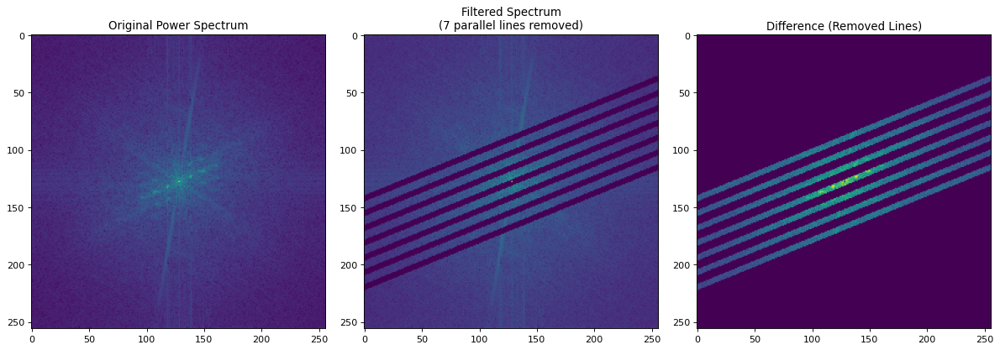

In [41]:
F_filtered_primate, S_filtered_display_primate, S_original_display_primate = apply_diagonal_notch_filter(
    primate_image,
    peaks,
    line_thickness=5,  # Adjust to control thickness
    do_shifting=True,
    num_harmonics=3,
    dc_radius=0.5
)

Image Information:
Property             Value     
               Shape (256, 256)
           Data Type      uint8
        Total Pixels     65,536
          Dimensions          2
Memory Usage (bytes)     65,536
     Min Pixel Value          1
     Max Pixel Value        237
    Mean Pixel Value     107.02
  Standard Deviation      28.30


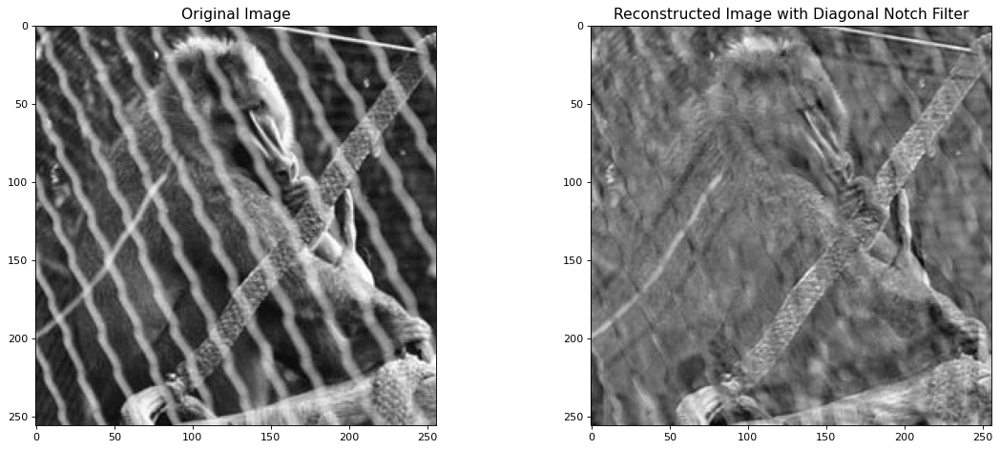

In [42]:
# Reconstruct the image using ifft
inverseft, primate_image_reconstructed = inverse_fourier_transform(F_filtered_primate)
print_image_info(primate_image_reconstructed)
display_images_side_by_side(primate_image, primate_image_reconstructed, title1 = "Original Image", title2 = "Reconstructed Image with Diagonal Notch Filter")

Run some quick hyperparameter tuning to get results

In [43]:
# Store images with different thickness values for subplot display
thickness_values = range(1, 6)
reconstructed_images = []
thickness_labels = []

# Process images with different thickness values
for i in thickness_values:
    F_filtered_primate, S_filtered_display_primate, S_original_display_primate = apply_diagonal_notch_filter(
        primate_image,
        peaks,
        line_thickness=i,  # Adjust to control thickness
        do_shifting=True,
        num_harmonics=3,
        dc_radius=5,
        visualize=False
    )
    # Reconstruct the image using ifft
    inverseft, primate_image_reconstructed = inverse_fourier_transform(F_filtered_primate)
    
    # Store the reconstructed image and its label
    reconstructed_images.append(primate_image_reconstructed)
    thickness_labels.append(f"Thickness = {i}")
    
    print(f"Processed thickness = {i}")

print(f"Stored {len(reconstructed_images)} reconstructed images")

Image size: 256x256
Spectrum center: (128, 128)
Number of peaks: 3
Harmonics to remove: 3 on each side
DC protection: ON (radius=5)
Working in shifted coordinate space

Primary line from (118, 133) to (96, 142)
Line equation: y = -0.409x + 181.273
Harmonic spacing: 11.9 pixels
Line length: 512.0 pixels
Harmonic -3: 279 pixels
Main line: 257 pixels
Harmonic +3: 279 pixels
Total pixels zeroed: 1933

Shifted back to original space
Processed thickness = 1
Image size: 256x256
Spectrum center: (128, 128)
Number of peaks: 3
Harmonics to remove: 3 on each side
DC protection: ON (radius=5)
Working in shifted coordinate space

Primary line from (118, 133) to (96, 142)
Line equation: y = -0.409x + 181.273
Harmonic spacing: 11.9 pixels
Line length: 512.0 pixels
Harmonic -3: 547 pixels
Main line: 530 pixels
Harmonic +3: 546 pixels
Total pixels zeroed: 3857

Shifted back to original space
Processed thickness = 2
Image size: 256x256
Spectrum center: (128, 128)
Number of peaks: 3
Harmonics to remove: 

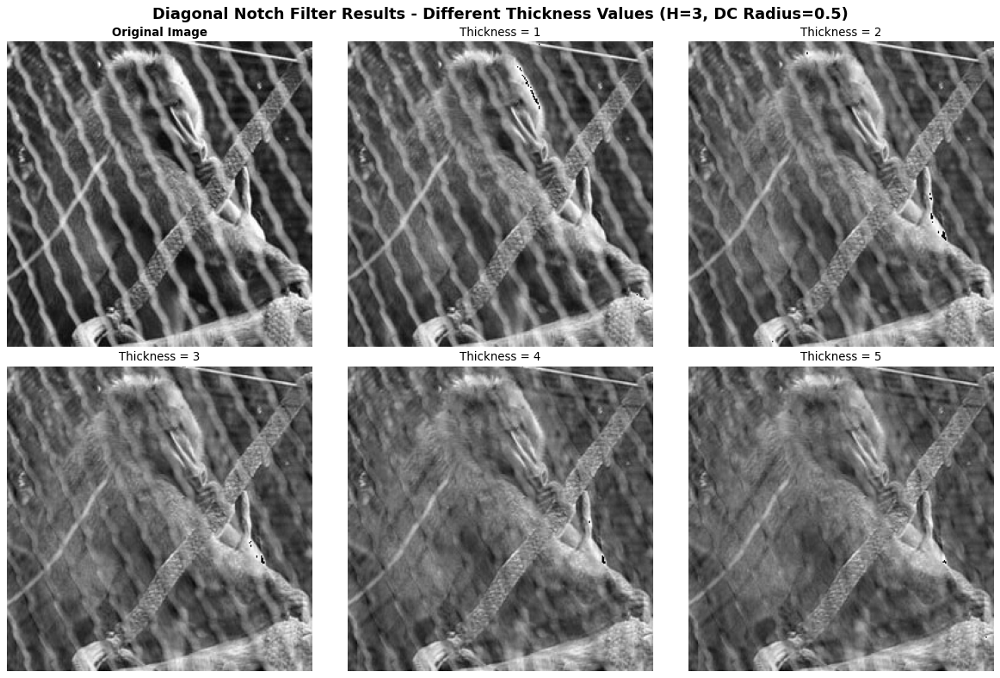

In [44]:
# Display all images as subplots
def display_multiple_images_subplot(original_image, processed_images, labels, main_title="Image Comparison"):
    """
    Display original image alongside multiple processed images in a subplot grid
    
    Parameters:
    - original_image: The original image to display
    - processed_images: List of processed images
    - labels: List of labels for each processed image
    - main_title: Main title for the entire figure
    """
    n_images = len(processed_images)
    n_cols = 3  # Number of columns in subplot grid
    n_rows = (n_images + n_cols) // n_cols  # Calculate rows needed (including original)
    
    # Create figure with subplots
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(15, 5 * n_rows))
    
    # Flatten axes array for easier indexing
    if n_rows == 1:
        axes = axes.reshape(1, -1)
    axes = axes.flatten()
    
    # Display original image in first subplot
    axes[0].imshow(original_image, cmap='gray')
    axes[0].set_title("Original Image", fontsize=12, fontweight='bold')
    axes[0].axis('off')
    
    # Display processed images
    for i, (img, label) in enumerate(zip(processed_images, labels)):
        axes[i + 1].imshow(img, cmap='gray')
        axes[i + 1].set_title(label, fontsize=12)
        axes[i + 1].axis('off')
    
    # Hide any unused subplots
    for i in range(n_images + 1, len(axes)):
        axes[i].axis('off')
    
    plt.suptitle(main_title, fontsize=16, fontweight='bold')
    plt.tight_layout()
    plt.show()

# Display all the images in a single subplot
display_multiple_images_subplot(
    primate_image, 
    reconstructed_images, 
    thickness_labels,
    main_title="Diagonal Notch Filter Results - Different Thickness Values (H=3, DC Radius=0.5)"
)


From my proposed method, it seems that the best working thickness of 4, with 3 repeated harmonics and DC protection radius of 0.5 works the bes. Although the image looks relatively grey-ish, one can still make the features out of an animal, and the fence is still visible, but not as visible as before. DC protection was needed to prevent the image from becoming too dark as setting it to 0 would cause the mean intensity of the image to be 0. Regardless, although the result was not clean, its the best we can do at this point of time with just simple notch filtering. It is really hard to patch back parts that are obscured initially by the fence without some form of informed analysis of the image.

---
## 1.6 Undoing Perspective Distortion of Planar Surface

The goal in this part of the experiment is to take an original slanted view of a book, and compute the projective transformation to warp the image to a frontal view. The final warped image should have the scale 1 pixel (image) = 1mm (book dimension).

### Part A - Loading and Displaying the Book Image

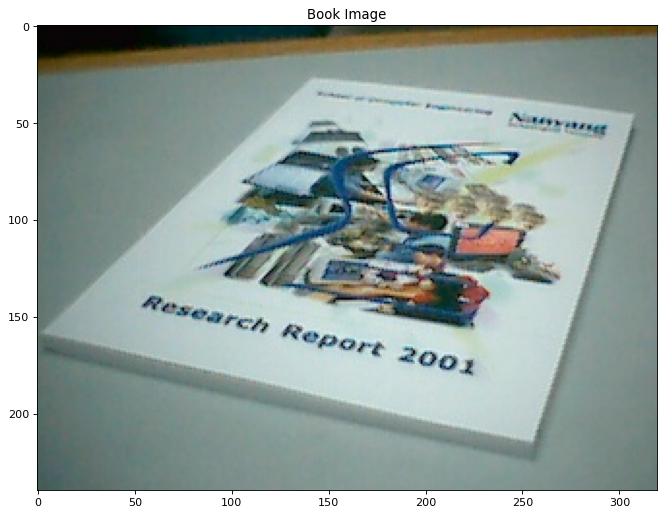

Image Information:
Property             Value        
               Shape (240, 320, 3)
           Data Type         uint8
        Total Pixels       230,400
          Dimensions             3
Memory Usage (bytes)       230,400
     Min Pixel Value             0
     Max Pixel Value           255
    Mean Pixel Value        145.26
  Standard Deviation         48.46


In [45]:
book_image = load_image("../assets/book.jpg", is_greyscale=False)
display_image(book_image, title = "Book Image", grey=False)
print_image_info(book_image)

### Part B - Getting Corner Coordinates of Book

In [46]:
# Coordinates using ginput in MATLAB - (Top Left, Top Right, Bottom Right, Bottom Left)
x_coords = np.array([141.9, 308.7, 256.8, 4.23])
y_coords = np.array([29.1, 47.2, 215.1, 159.7])

# The A4 paper size is 210 x 297mm
x_a4 = np.array([0, 210, 210, 0])
y_a4 = np.array([0, 0, 297, 297])

# Make both into numpy arrays, but use vertical stack to merge coords, then transpose
source_coords = np.vstack([x_coords, y_coords]).T
target_coords = np.vstack([x_a4, y_a4]).T

print(f"Source Coordinates: {source_coords}")
print(f"Target Coordinates: {target_coords}")


Source Coordinates: [[141.9   29.1 ]
 [308.7   47.2 ]
 [256.8  215.1 ]
 [  4.23 159.7 ]]
Target Coordinates: [[  0   0]
 [210   0]
 [210 297]
 [  0 297]]


### Part C - Setting up Matrices to Estimate Projective Transformation

In the manual, the 2D planar projective transform is expressed via this 3 by 3 matrix
$$
\begin{bmatrix} kx_{im} \\ ky_{im} \\ k \end{bmatrix} = \begin{bmatrix} m_{11} & m_{12} & m_{13} \\ m_{21} & m_{22} & m_{23} \\ m_{31} & m_{32} & 1 \end{bmatrix} \begin{bmatrix} X_w \\ Y_w \\ 1 \end{bmatrix}
$$
where (x_im, y_im) are coordinates in the **output** image. or the corrected frontal view.
k is some scaling factor.

(X_w, Y_w) are coordinates in the **input** image, or the distorted photo.
The 3x3 matrix with m values is the transformation we are actually trying to find.

The manual also shows this algebraic form, which is actually just simple matrix multiplication.
$$
x_{im} = \frac{m_{11}X_w + m_{12}Y_w + m_{13}}{m_{31}X_w + m_{32}Y_w + 1}
$$
$$
y_{im} = \frac{m_{21}X_w + m_{22}Y_w + m_{23}}{m_{31}X_w + m_{32}Y_w + 1}
$$

If we just do the matrix multiplication, $$ k ={m_{31}X_w + m_{32}Y_w + 1} $$, to find x_im is just to do the same but divide by k. **k is actually what creates the perspective effect.**

---
Since the bottom right is one, there are 8 unknowns to find.
$$
\begin{bmatrix} m_{11} & m_{12} & m_{13} \\ m_{21} & m_{22} & m_{23} \\ m_{31} & m_{32} & 1 \end{bmatrix}
$$

For each point we know, we can write 2 equations, one for x and one for y. (just simple matrix multiplicationp)
$$
X_w^1 \cdot m_{11} + Y_w^1 \cdot m_{12} + m_{13} + 0 \cdot m_{21} + 0 \cdot m_{22} + 0 \cdot m_{23} - x_{im}^1 X_w^1 \cdot m_{31} - x_{im}^1 Y_w^1 \cdot m_{32} = x_{im}^1
$$
and for y
$$
0 \cdot m_{11} + 0 \cdot m_{12} + 0 \cdot m_{13} + X_w^1 \cdot m_{21} + Y_w^1 \cdot m_{22} + m_{23} - y_{im}^1 X_w^1 \cdot m_{31} - y_{im}^1 Y_w^1 \cdot m_{32} = y_{im}^1
$$

Then we have the big matrix Au=v seen in the manual. We want to calculate u which is the 8x1 vector of unknowns. We know the initial, we know the output. We just need to take the inverse of A times v to get u. Or theres a least squares solution i think if we have more than 4 points

$$
\mathbf{u} = A^{-1} \mathbf{v}
$$

$$
\mathbf{u} = (A^T A)^{-1} A^T \mathbf{v}
$$

---

To verify: once we have the transformation matrix U
$$\mathbf{w} = U \begin{bmatrix} X_w \\ Y_w \\ 1 \end{bmatrix}$$
And after normalization
$$\begin{bmatrix} x_{im} \\ y_{im} \end{bmatrix} = \begin{bmatrix} \mathbf{w}_1 / \mathbf{w}_3 \\ \mathbf{w}_2 / \mathbf{w}_3 \end{bmatrix}$$

we should match the target coordinates.


In [47]:
# We could just use cv2.getPerspectiveTransform, but it seems they are asking to do it manually...?
# From the manual.
# A is an 8x8 matrix, and b is a 8x1 vector.

def setup_projection_matrices(source_coords, target_coords):
    """
    This function manually constructs the A matrix and v vector for projective transformation I guess

    For each point (Xw, Yw) to be projected onto (x_im, y_im), we get two equations by consulting the A matrix in the manual
    Row 1: = [Xw Yw 1 0 0 0 0 -x_im*Xw -x_im*Yw]
    Row 2: = [0 0 0 Xw Yw 1 -y_im*Xw -y_im*Yw]
    """
    n_points = len(source_coords)
    A = np.zeros((2 * n_points, 8))
    v = np.zeros(2 * n_points)

    for i in range(n_points):
        Xw, Yw = source_coords[i]
        x_im, y_im = target_coords[i]

         # First equation to get the xcoords
        A[2*i] = [Xw, Yw, 1, 0, 0, 0, -x_im*Xw, -x_im*Yw]
        v[2*i] = x_im
        
        # Second equation (for y coordinate)
        A[2*i + 1] = [0, 0, 0, Xw, Yw, 1, -y_im*Xw, -y_im*Yw]
        v[2*i + 1] = y_im
    
    return A, v

A, v = setup_projection_matrices(source_coords, target_coords)
print(f"A = {A}")
print(f"v = {v}")

# Solve for u, this is u = A inverse * v
u = np.linalg.solve(A, v)
print(f"Transformation parameters u = {u}")

# We also need to reshape u to be a 3x3 matrix as said in the lab manual
U = np.concatenate([u, [1]]).reshape(3, 3)
print("\nProjective Transformation Matrix U (3x3):")
print(U)

A = [[   141.9      29.1       1.        0.        0.        0.        0.
       0.  ]
 [     0.        0.        0.      141.9      29.1       1.        0.
       0.  ]
 [   308.7      47.2       1.        0.        0.        0.   -64827.
   -9912.  ]
 [     0.        0.        0.      308.7      47.2       1.        0.
       0.  ]
 [   256.8     215.1       1.        0.        0.        0.   -53928.
  -45171.  ]
 [     0.        0.        0.      256.8     215.1       1.   -76269.6
  -63884.7 ]
 [     4.23    159.7       1.        0.        0.        0.        0.
       0.  ]
 [     0.        0.        0.        4.23    159.7       1.    -1256.31
  -47430.9 ]]
v = [  0.   0. 210.   0. 210. 297.   0. 297.]
Transformation parameters u = [   1.49936359    1.58053129 -258.75315434   -0.41234874    3.79998732
  -52.06734419    0.00023532    0.00539207]

Projective Transformation Matrix U (3x3):
[[   1.49936359    1.58053129 -258.75315434]
 [  -0.41234874    3.79998732  -52.06734419]
 [  

#### Sub Part: Verify our U Matrix vs cv2's U Matrix

After inspection, our U was calculated accurately with some inaccuracy due to computer precision.

In [48]:
U_cv2 = cv2.getPerspectiveTransform(source_coords.astype(np.float32), target_coords.astype(np.float32))
print("="*60)
print("COMPARISON: Manual vs OpenCV")
print("="*60)
print("\nOur U matrix:")
print(U)
print("\nOpenCV's U matrix:")
print(U_cv2)
print("\nDifference (ours - cv2):")
print(U - U_cv2)
print(f"\nMax absolute error: {np.max(np.abs(U - U_cv2)):.6f}")

COMPARISON: Manual vs OpenCV

Our U matrix:
[[   1.49936359    1.58053129 -258.75315434]
 [  -0.41234874    3.79998732  -52.06734419]
 [   0.00023532    0.00539207    1.        ]]

OpenCV's U matrix:
[[   1.49936356    1.58053122 -258.75313966]
 [  -0.41234869    3.79998713  -52.06735074]
 [   0.00023532    0.00539207    1.        ]]

Difference (ours - cv2):
[[ 0.00000003  0.00000006 -0.00001468]
 [-0.00000006  0.00000019  0.00000655]
 [-0.          0.          0.        ]]

Max absolute error: 0.000015


In [49]:
# Create the homogenous source like the manual [X'; Y'; ones(1,4)]
print("target_coords:\n", target_coords)
homogenous_source = np.vstack([source_coords.T, np.ones(4)])
print(f"Homogenous source: {homogenous_source}")

# Calculate w = U * homogenous_source
w = U @ homogenous_source
print(f"After transformation (w):\n {w}")

# Normalize w = w ./ (ones(3,1) * w(3,:))
# This divides each column by its third element
w_normalized = w / w[2, :]
print("After normalization (w / w[2,:]):")
print(w_normalized)

# Extract the x and y coordinates (first 2 rows of w_normalized)
transformed_coords = w_normalized[:2, :].T
print(f"Transformed coordinates:\n {transformed_coords}")

# Print difference between target and transformed coordinates
difference = transformed_coords - target_coords
print(f"Difference: {difference}")
print(f"Max absolute difference: {np.max(np.abs(difference)):.6f}")

target_coords:
 [[  0   0]
 [210   0]
 [210 297]
 [  0 297]]
Homogenous source: [[141.9  308.7  256.8    4.23]
 [ 29.1   47.2  215.1  159.7 ]
 [  1.     1.     1.     1.  ]]
After transformation (w):
 [[ -0.         278.70146367 466.25569605  -0.        ]
 [  0.           0.         659.41877013 553.04639498]
 [  1.19030153   1.32714983   2.22026522   1.86210907]]
After normalization (w / w[2,:]):
[[ -0. 210. 210.  -0.]
 [  0.   0. 297. 297.]
 [  1.   1.   1.   1.]]
Transformed coordinates:
 [[ -0.   0.]
 [210.   0.]
 [210. 297.]
 [ -0. 297.]]
Difference: [[-0.  0.]
 [ 0.  0.]
 [ 0.  0.]
 [-0. -0.]]
Max absolute difference: 0.000000


Overall, our projection matrix that was manually calculated has done the trick, and cv2's perspective function would have worked the same.

### Part D & E - Warp the Image and Display

Using cv2 warp perspective https://docs.opencv.org/4.x/da/d54/group__imgproc__transform.html

https://docs.opencv.org/4.x/da/d54/group__imgproc__transform.html#gaf73673a7e8e18ec6963e3774e6a94b87

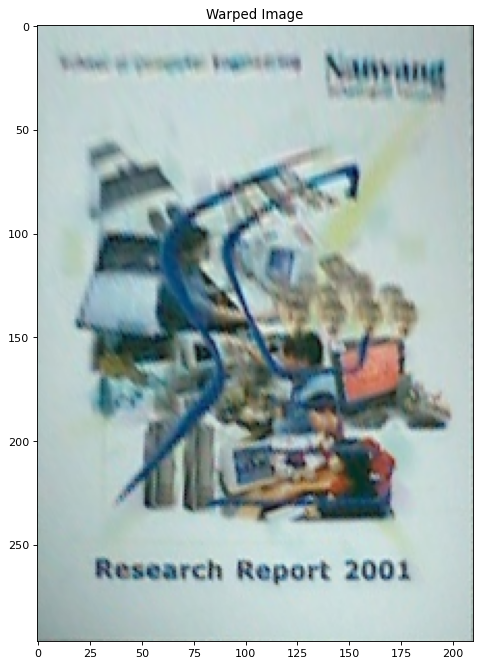

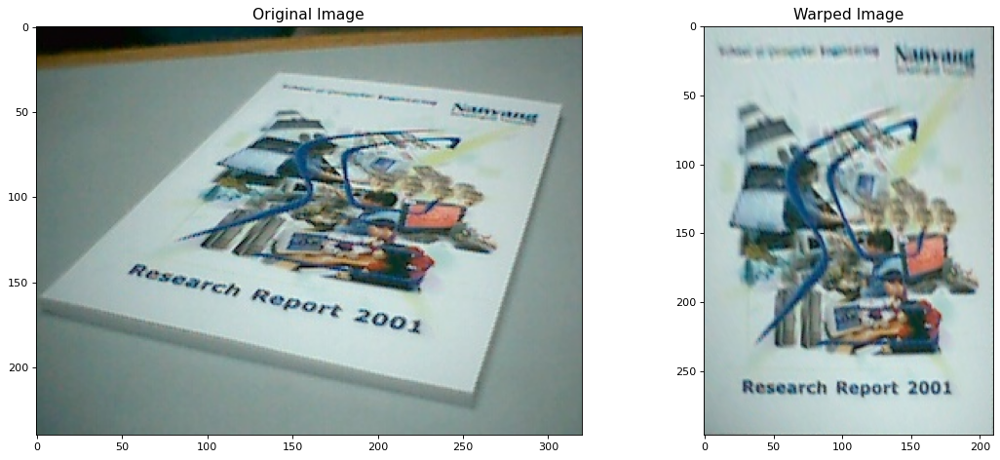

Image Information:
Property             Value        
               Shape (297, 210, 3)
           Data Type         uint8
        Total Pixels       187,110
          Dimensions             3
Memory Usage (bytes)       187,110
     Min Pixel Value             0
     Max Pixel Value           250
    Mean Pixel Value        169.36
  Standard Deviation         49.72


In [50]:
warped_image = cv2.warpPerspective(book_image, U, (210, 297))
display_image(warped_image, title = "Warped Image", grey=False)
display_images_side_by_side(book_image, warped_image, title1 = "Original Image", title2 = "Warped Image")
print_image_info(warped_image)

**Observations**

After warping, the perspective correction was successful. The book is now showing a frontal view with no more trapezoidal distortion or shape like the original image. The image dimensions are also correct, with the image having 210x297 pixels matching A4 proportions at 1 pixel = 1mm scale. The text is roughly readable,the Nanyang and Research Report 2001 words are readable.

However, we do face some blurriness and low-resolution, with loss of detail, some fine details are lost when compared to the original. Some possible causes can be that due to the mapping, this typically requires interpolation (estimation of pixel values at non integer positions.)

In warp perspective, it uses nearest neighbour or bilinear interpolation, which can cause blur. If we want higher quality, we need higher order interpolations. Furthermore, since the original photo seems to be taken at low resolution, after the "flattening" process, we are trying to reconstruct detail that wasnt captured well originally. Even on the book, the top text beside Nanyang takes less pixels and when warped to frontal view, these areas are "stretched" from limited data and causes even more blur.

### Part F - Identify Big Rectangular Pink Area.

In the lab manual, it is not stated what I should do with the pink area. I assume I have to enhance it using some methods available.


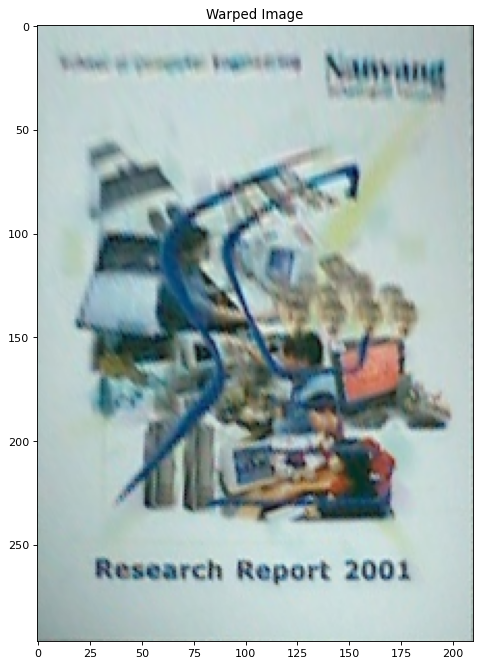

In [51]:
warped_image = cv2.warpPerspective(book_image, U, (210, 297))
display_image(warped_image, title = "Warped Image", grey=False)

In this section, we are tasked to identify the big rectangular pink area using any methods we wish. From visual inspection, the computer screen is full of pink pixels, and the rest of the image does not. Due to this, we are able to use color masking by isolating pixels within a specific color range to find a target object. For color detection, working in the HSV (Hue-Saturation-Value) space is better for color detection as the hue (color) is separated from the brightness of the image.

Screen detected at: (147, 151), size: 30x30


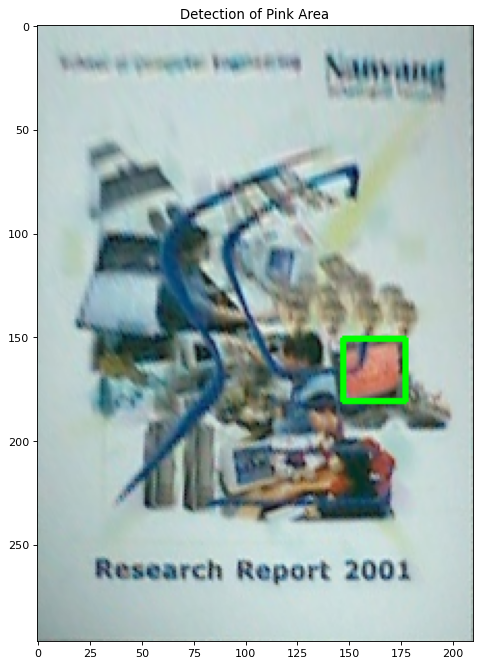

In [52]:
def detect_screen(img):
    """
    Detect using refined color range
    """
    # Convert to HSV
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
    
    # Based on the pink screen color range
    lower = np.array([104, 30, 50])
    upper = np.array([124, 255, 255])
    
    mask = cv2.inRange(hsv, lower, upper)
    
    # Find contours
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    
    result = img.copy()
    if contours:
        largest = max(contours, key=cv2.contourArea)
        x, y, w, h = cv2.boundingRect(largest)
        cv2.rectangle(result, (x, y), (x+w, y+h), (0, 255, 0), 2)
        print(f"Screen detected at: ({x}, {y}), size: {w}x{h}")
    
    return result

result = detect_screen(warped_image)
display_image(result, title="Detection of Pink Area", grey=False)

Screen detected at: (129, 177), size: 34x29


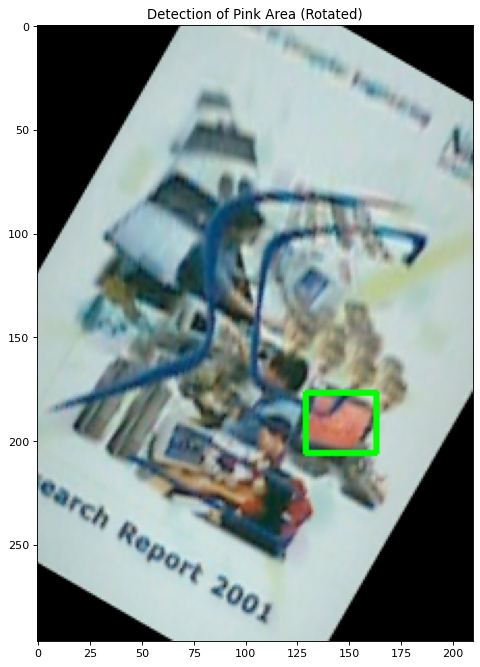

Screen detected at: (177, 171), size: 30x30


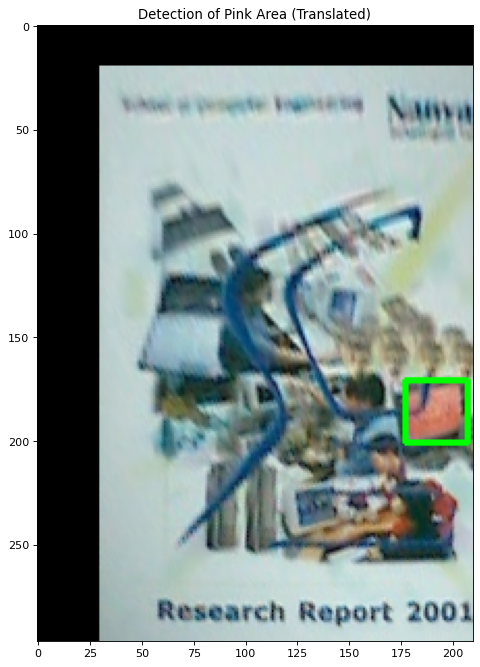

In [53]:
h, w = warped_image.shape[:2]
angle = -30
center = (w // 2, h // 2)
rotation_matrix = cv2.getRotationMatrix2D(center, angle, 1.0)
rotated_image = cv2.warpAffine(warped_image, rotation_matrix, (w, h))
result = detect_screen(rotated_image)
display_image(result, title="Detection of Pink Area (Rotated)", grey=False)

tx, ty = 30, 20
translation_matrix = np.float32([[1, 0, tx], [0, 1, ty]])
translated_image = cv2.warpAffine(warped_image, translation_matrix, (w, h))
result = detect_screen(translated_image)
display_image(result, title="Detection of Pink Area (Translated)", grey=False)

---
## 1.7 Coding Two Perceptrons from Lecture Slides

The decision boundary can be represented in different ways, as seen in the slides. The summation form is just the linear combination expressed in short form, while the vector form is whats commonly known, W^Tx + Wn+1 (usually this is the bias). The seperation rule uses 0 as the binary classifier.  After the sum is passed into the activation function, we would get outputs and we can get the actual output.

### Algorithm 1 - Simple Perceptron Training
From Algorithm 1, the weights are simply adjusted based on classification accuracy to find a linear decision boundary that accurately seperates the two classes. On classification error, weights are updated accordingly and the boundary is shifted accordingly, while correct classifications makes the weight remain unchanged. In the slides, the algorithm alternates between x1 and x2 on even and odd iterations to iteratively test between each point. The learning rate and bias is also kept at 1 throughout the experiment, wiith no updates. THis is a simple learning algorithm to demosntrate how perceptron works.

In [54]:
# Setup the inputs and parameters
x1 = np.array([3, 3, 1]) #belongs to c1
x2 = np.array([1, 1, 1]) #belongs to c2
weights = np.array([0, 0, 0]) # weights initially all 

lr = 1 # learning rate set as 1 as per dlecture slides
# 100 should be enough to find a solution, especially since its just binary classification
# But if we want the best representing line, more iterations till convergence is better
def train(x1, x2, weights, lr, early_stop=False, max_epochs=100, early_stop_threshold=3):
    # Store original weights
    old_weights = np.copy(weights)
    weights = np.copy(weights)
    early_stop_count = 0
    epsilon = 1e-6
    # Copy vectors
    x1 = np.copy(x1)
    x2 = np.copy(x2)
    # Assume we start at epoch 1, the results will be different if we classify and optimize from x2 instead
    for epoch in range(1, max_epochs + 1):
        # From the slides example, it seems for odd iterations we try to classify x1, and then even for x2
        # For early stopping, we can just say that if we have classified both points correctly, we stop without finding the optimal line
        if epoch % 2 == 1:
            # Classify x1 sing np dot product
            classification = np.dot(weights, x1)
            if classification > 0:
                # If correct, no update
                pass
            else:
                # Incorrect, update weights based on lr * x
                weights += lr * x1
        else:
            # Classify x2 using np dot product
            classification = np.dot(weights, x2)
            if classification < 0:
                # If correct, no update
                pass
            else:
                # Incorrect, update weights based on - lr * x
                weights -= lr * x2

        # Check for early stopping based on weight diff to calculcate L2 norm
        weight_diff = np.linalg.norm(old_weights - weights)
        if weight_diff < epsilon:
            early_stop_count += 1
        else:
            # Update old weights
            old_weights = np.copy(weights)
            early_stop_count = 0

        # Check for early stopping
        if early_stop and early_stop_count == early_stop_threshold:
            return epoch, weights
    return epoch, weights


final_epoch, final_weights = train(x1, x2, weights, lr, early_stop=True, max_epochs=100)
print(f"Final weights: {final_weights}")
print(f"Epochs taken: {final_epoch}")

# With no early stop for best seperating line
final_epoch, final_weights = train(x1, x2, weights, lr, early_stop=False, max_epochs=100)
print(f"Final weights: {final_weights}")
print(f"Epochs taken: {final_epoch}")

Final weights: [ 1  1 -3]
Epochs taken: 13
Final weights: [ 1  1 -3]
Epochs taken: 100


No difference between early stopping and just training it for 100 iterations. I don't think this is the best line there is, but we shall just plot it 
anyway.

#### Algorithm 1 - Plotting Decision Boundary

To solve for x, we need in form of y as a function of x

1. Starting equation
$$ w_1 * xs_1 + w_2 * x_2 + w_3 = 0$$
2. Isolate x_2 (y)
$$ w_2 *x_2 = -w_1*x_1 - w_3 = 0$$
3. Divide both sides by w_2
$$x_2 = (-w_1*x_1-w_3)/w_2$$
4. Rearrange to factor our negative
$$ x_2 = (-w_3 - w_1*x_1) / w_2 $$
5. With calculated weights [1 1 -3]
$$x_2 = ((-3) - 1*x_1) / 1$$
$$x_2 = (3-x_1)/1$$
$$ x_2 = 3-x_1 $$

[3 3] [1 1]


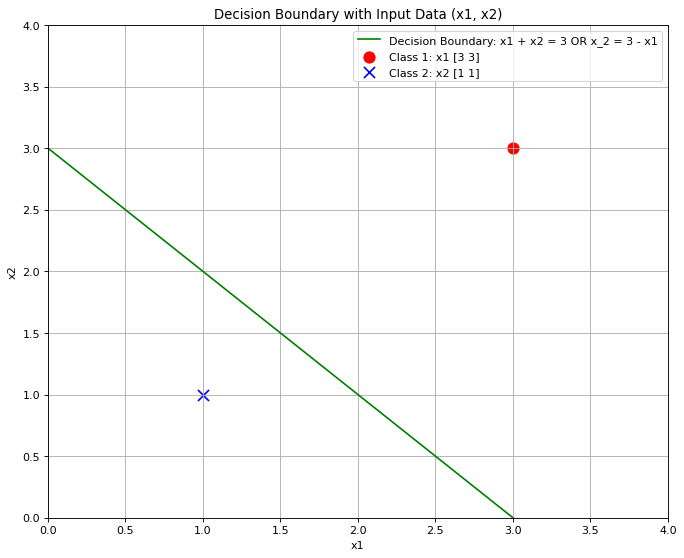

In [55]:
# From the previous part, we have the final weights that we can use 
# Remove bias term from initial x1 and x2
x1 = x1[:2]
x2 = x2[:2]
print(x1, x2)

# Create decision boundary from the final weights, which is x1+x2 =3
# Solve for y to get the line equation
# Create points for calculation of line, these are the x1 values to calculate the line in question
boundary_x = np.linspace(0, max(x1[0], x2[0]) + 1, 100)
boundary_y = (-final_weights[2] - final_weights[0] * boundary_x) / final_weights[1]

# Plotting of decision boundary
plt.figure(figsize=(10, 8))
plt.plot(boundary_x, boundary_y, label='Decision Boundary: x1 + x2 = 3 OR x_2 = 3 - x1', color='green')
# Automatically adjust for different graph size given different inputs
plt.xlim(0, max(x1[0], x2[0]) + 1)
plt.ylim(0, max(x1[1], x2[1]) + 1)
# Setting of labels
plt.xlabel('x1')
plt.ylabel('x2')
plt.title('Decision Boundary with Input Data (x1, x2)')
# Plotting of the points
plt.scatter(x1[0], x1[1], c='red', marker='o',  label=f'Class 1: x1 {x1}', s=100)
plt.scatter(x2[0], x2[1], c='blue', marker='x', label=f'Class 2: x2 {x2}', s=100)
plt.legend()
plt.grid(True)
plt.show()

From human inspection, the points are seperarted cleanly, the classification works as is. However, the problem with perceptrons is that it gives non unique solutions. When we calculate x_1 + x_2 = 3, any line where 2 < (x1+x2) < 6 should theoreitically work. The best line is the line that maximises the margin, the distance to nearest points from both classes. The line should have the following properties:

1. Pass through or near the midpoint
2. Be perpendicular to the line connecting the points

We can plot out the best linee using calculations similar to Support Vector Machines. 

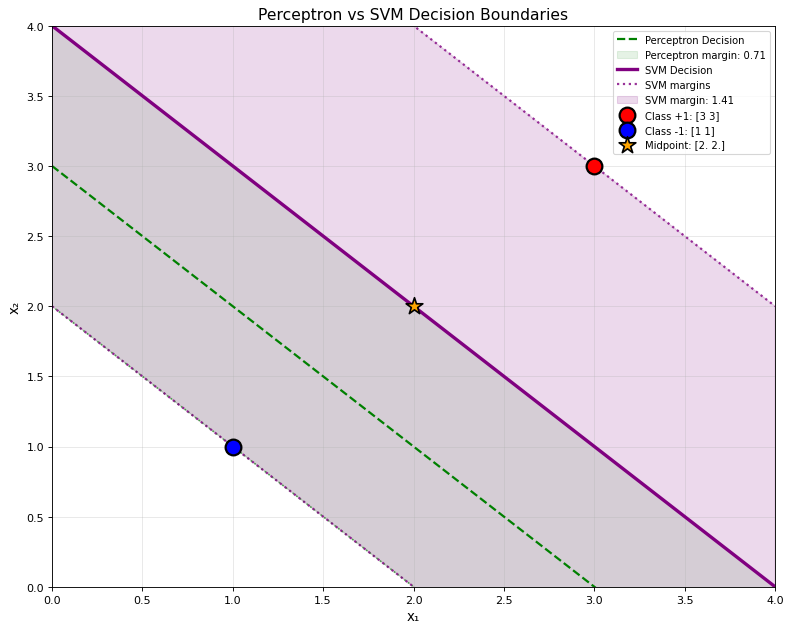

Perceptron margin: 0.707
SVM margin: 1.414
Improvement: 2.00x
{'perceptron_margin': np.float64(0.7071067811865475), 'svm_margin': np.float64(1.414213562373095), 'perceptron_weights': array([ 1,  1, -3]), 'optimal_weights': array([ 2.,  2., -8.])}


In [56]:
def plot_perceptron_vs_svm(x1, x2, perceptron_weights, figsize=(10, 8)):    
    # Remove bias term if present
    x1_2d = x1[:2] if len(x1) == 3 else x1
    x2_2d = x2[:2] if len(x2) == 3 else x2
    
    # Calculate optimal line using midpoint
    midpoint = (x1_2d + x2_2d) / 2
    direction = x1_2d - x2_2d
    
    # Find optimal w for SVM
    optimal_w = np.array([
        direction[0], 
        direction[1], 
        -(direction[0]*midpoint[0] + direction[1]*midpoint[1])
    ])
    
    # Margin boundaries
    upper_margin_c = -(optimal_w[0]*x1_2d[0] + optimal_w[1]*x1_2d[1])
    lower_margin_c = -(optimal_w[0]*x2_2d[0] + optimal_w[1]*x2_2d[1])
    margin_distance = abs(upper_margin_c - lower_margin_c) / np.sqrt(optimal_w[0]**2 + optimal_w[1]**2)
    
    # Calculate point to line distance to find out margin
    def point_to_line_distance(point, w1, w2, w3):
        return abs(w1*point[0] + w2*point[1] + w3) / np.sqrt(w1**2 + w2**2)
    
    # Find margin against each x1 and x2 point.
    perceptron_margin_x1 = point_to_line_distance(x1_2d, perceptron_weights[0], 
                                                   perceptron_weights[1], perceptron_weights[2])
    perceptron_margin_x2 = point_to_line_distance(x2_2d, perceptron_weights[0], 
                                                   perceptron_weights[1], perceptron_weights[2])
    # The bottleneck is the point closest to the line, so we take the minimum of both
    perceptron_min_margin = min(perceptron_margin_x1, perceptron_margin_x2)
    
    
    boundary_x = np.linspace(min(x1_2d[0], x2_2d[0]) - 1, max(x1_2d[0], x2_2d[0]) + 1, 100)
    
    # Perceptron
    boundary_y_perceptron = (-perceptron_weights[2] - perceptron_weights[0] * boundary_x) / perceptron_weights[1]
    perceptron_norm = np.sqrt(perceptron_weights[0]**2 + perceptron_weights[1]**2)
    upper_perceptron_c = perceptron_weights[2] - perceptron_min_margin * perceptron_norm
    lower_perceptron_c = perceptron_weights[2] + perceptron_min_margin * perceptron_norm
    boundary_y_perceptron_upper = (-upper_perceptron_c - perceptron_weights[0] * boundary_x) / perceptron_weights[1]
    boundary_y_perceptron_lower = (-lower_perceptron_c - perceptron_weights[0] * boundary_x) / perceptron_weights[1]
    
    # SVM
    boundary_y_decision = (-optimal_w[2] - optimal_w[0] * boundary_x) / optimal_w[1]
    boundary_y_upper = (-upper_margin_c - optimal_w[0] * boundary_x) / optimal_w[1]
    boundary_y_lower = (-lower_margin_c - optimal_w[0] * boundary_x) / optimal_w[1]
    
    plt.figure(figsize=figsize)
    # Perceptron
    plt.plot(boundary_x, boundary_y_perceptron, 'g--', linewidth=2, label='Perceptron Decision')
    plt.plot(boundary_x, boundary_y_perceptron_upper, 'g:', linewidth=1.5, alpha=0.6)
    plt.plot(boundary_x, boundary_y_perceptron_lower, 'g:', linewidth=1.5, alpha=0.6)
    plt.fill_between(boundary_x, boundary_y_perceptron_lower, boundary_y_perceptron_upper,
                     alpha=0.1, color='green', label=f'Perceptron margin: {perceptron_min_margin:.2f}')
    # SVM
    plt.plot(boundary_x, boundary_y_decision, 'purple', linewidth=3, label='SVM Decision')
    plt.plot(boundary_x, boundary_y_upper, 'purple', linewidth=2, linestyle=':', alpha=0.8, label='SVM margins')
    plt.plot(boundary_x, boundary_y_lower, 'purple', linewidth=2, linestyle=':', alpha=0.8)
    plt.fill_between(boundary_x, boundary_y_lower, boundary_y_upper, 
                     alpha=0.15, color='purple', label=f'SVM margin: {margin_distance/2:.2f}')
    # Points
    plt.scatter(x1_2d[0], x1_2d[1], c='red', marker='o', s=200, zorder=5, 
                edgecolors='black', linewidths=2, label=f'Class +1: {x1_2d}')
    plt.scatter(x2_2d[0], x2_2d[1], c='blue', marker='o', s=200, zorder=5, 
                edgecolors='black', linewidths=2, label=f'Class -1: {x2_2d}')
    plt.scatter(midpoint[0], midpoint[1], c='orange', marker='*', s=250, zorder=5, 
                edgecolors='black', linewidths=1.5, label=f'Midpoint: {midpoint}')
    
    # Limits and labels
    plt.xlim(min(x1_2d[0], x2_2d[0]) - 1, max(x1_2d[0], x2_2d[0]) + 1)
    plt.ylim(min(x1_2d[1], x2_2d[1]) - 1, max(x1_2d[1], x2_2d[1]) + 1)
    plt.xlabel('x₁', fontsize=12)
    plt.ylabel('x₂', fontsize=12)
    plt.title('Perceptron vs SVM Decision Boundaries', fontsize=14)
    plt.legend(loc='best', fontsize=9)
    plt.grid(True, alpha=0.3)
    plt.tight_layout()
    plt.show()
    
    # Print results
    print(f"Perceptron margin: {perceptron_min_margin:.3f}")
    print(f"SVM margin: {margin_distance/2:.3f}")
    print(f"Improvement: {(margin_distance/2) / perceptron_min_margin:.2f}x")
    
    # Return results
    return {
        'perceptron_margin': perceptron_min_margin,
        'svm_margin': margin_distance/2,
        'perceptron_weights': perceptron_weights,
        'optimal_weights': optimal_w
    }

results = plot_perceptron_vs_svm(x1, x2, final_weights)
print(results)

From this, we can actually see the optimal line is the line that maximises the margin. If we can acquire the line that is in between them which maximises the margin of each side while staying perpendicular, we have a better seperation. To achieve this, we need an algorithm that explicitly optimizes for margin (like SVM) rather than the perceptron which only ensures correct classification. It is a fundamentally different problem in that case.

## Algorithm 2 - Perceptron with Gradient Descent

Algorithm 2 represents a more sophisticated approach to perceptron learning by introducing a loss function to guide weight adjustments. Unlike Algorithm 1, where updates only happen when misclassification occurs, Algorithm 2 uses a least squares error function E(w) = 1/2(r-w^Tx)^2 to measure the difference between the predicted output (W^Tx) and the desired output r. This allows it to quantify numerically how far each prediction is. Since the loss function is differentiable, we can use gradiaent descent, where the derivative of the error function is calculated with respect to the weights, allowing us to create our update rule. In general, the weight adjustment is now scaled by the magnitude of the error, where larger mistakes trigger bigger corrections, and smaller errors result in finer adjustements, which creates a smoother convergence pattern. The learning are is typically small, and we can train until the error across all training samples becomes sufficient small.

Epoch 5, Loss: 0.6983, Weights: [ 0.36488353  0.36488353 -0.40601552]
Epoch 10, Loss: 0.5692, Weights: [ 0.1583134   0.1583134  -1.12465282]
Epoch 15, Loss: 0.4454, Weights: [ 0.60961643  0.60961643 -1.35581908]
Epoch 20, Loss: 0.3491, Weights: [ 0.45321961  0.45321961 -1.91486806]
Epoch 25, Loss: 0.2736, Weights: [ 0.80711367  0.80711367 -2.09592556]
Epoch 30, Loss: 0.2144, Weights: [ 0.68455168  0.68455168 -2.53404936]
Epoch 35, Loss: 0.1680, Weights: [ 0.96190016  0.96190016 -2.67594472]
Epoch 40, Loss: 0.1317, Weights: [ 0.86584784  0.86584784 -3.01930412]
Epoch 45, Loss: 0.1032, Weights: [ 1.08320697  1.08320697 -3.1305081 ]
Epoch 50, Loss: 0.0809, Weights: [ 1.00793037  1.00793037 -3.39960027]
Epoch 55, Loss: 0.0634, Weights: [ 1.17827561  1.17827561 -3.48675128]
Epoch 60, Loss: 0.0497, Weights: [ 1.11928104  1.11928104 -3.69763991]
Epoch 65, Loss: 0.0389, Weights: [ 1.2527813   1.2527813  -3.76594051]
Epoch 70, Loss: 0.0305, Weights: [ 1.20654701  1.20654701 -3.93121479]
Epoch 7

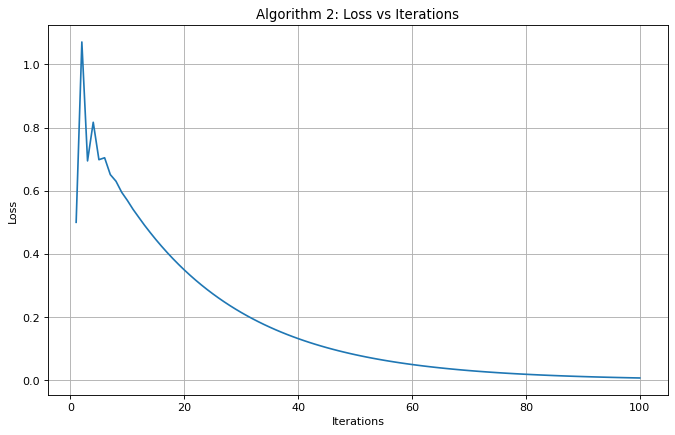

In [57]:
# Define all our parameters again like Algorithm 1
x1 = np.array([3, 3, 1]) #belongs to c1
x2 = np.array([1, 1, 1]) #belongs to c2
weights = np.array([0, 0, 0]) # weights initially all 0
lr = 0.5 # learning rate set as 0.5 to for better convergence
# 100 should be enough to find a solution, especially since its just binary classification
epochs = 100
r1 = 1  #the desired output for class 1
r2 = -1 # the desired output for class 2


def train_gradient_descent(x1, x2, weights, lr, epochs, r1, r2, max_epochs= 100, normalize = True):
    # Step 1 - We should normalize the vectors to prevent larger vectors dominating weight updates
    if normalize:
        x1_norm = x1 / np.linalg.norm(x1)
        x2_norm = x2 / np.linalg.norm(x2)
    else:
        x1_norm = x1
        x2_norm = x2
        
    # Initialize the weights
    weights = np.copy(weights)

    # Track loss over iterations for our visualizations
    losses = []

    # Iterate for our epochs
    for epoch in range (1, max_epochs + 1):
        # Alternate between two input, like in algorith,m 1
        x = x1_norm if epoch % 2 == 1 else x2_norm
        r = r1 if epoch % 2 == 1 else r2

        pred = np.dot(weights, x)
        error = r - pred
        # Calculate the loss
        loss = 0.5 * error ** 2
        losses.append(loss)
        # Update weights using grad descent, thne dertivative of loss function is -(r-W^Tx) * x
        # w(k+1) = w(k) + α[r(k) - w^T(k)x(k)]x(k)
        weights = weights + lr * error * x

        # Print progress every 5 epochs
        if epoch % 5 == 0:
            print(f"Epoch {epoch}, Loss: {loss:.4f}, Weights: {weights}")

    # Return the final weights and losses
    return epoch, weights, losses

final_epochs, final_weights, losses = train_gradient_descent(x1, x2, weights, lr, epochs, r1, r2, max_epochs=epochs, normalize=True)

# Plot the loss over iterations
plt.figure(figsize=(10, 6))
plt.plot(range(1, len(losses) + 1), losses)
plt.xlabel('Iterations')
plt.ylabel('Loss')
plt.title('Algorithm 2: Loss vs Iterations')
plt.grid(True)
plt.show()

#### Algorithm 2 - Plotting Decision Boundary

[3 3] [1 1]


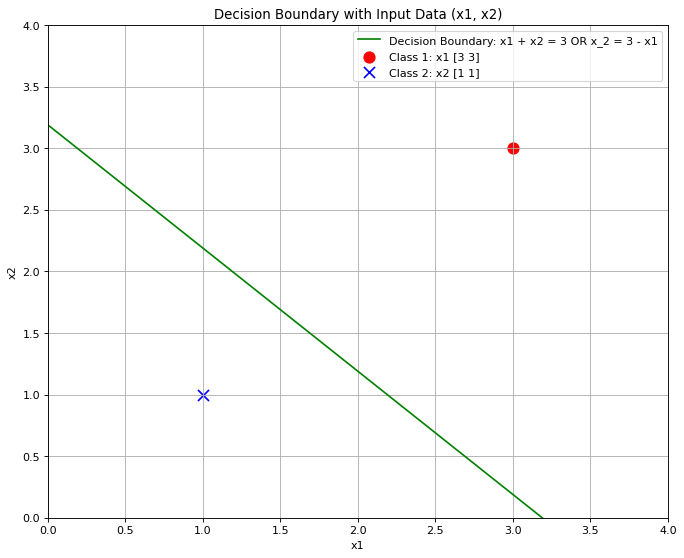

In [58]:
# From the previous part, we have the final weights that we can use 
# Remove bias term from initial x1 and x2
x1 = x1[:2]
x2 = x2[:2]
print(x1, x2)

# Create decision boundary from the final weights, which is x1+x2 =3
# Solve for y to get the line equation
# Create points for calculation of line, these are the x1 values to calculate the line in question
boundary_x = np.linspace(0, max(x1[0], x2[0]) + 1, 100)
boundary_y = (-final_weights[2] - final_weights[0] * boundary_x) / final_weights[1]

# Plotting of decision boundary
plt.figure(figsize=(10, 8))
plt.plot(boundary_x, boundary_y, label='Decision Boundary: x1 + x2 = 3 OR x_2 = 3 - x1', color='green')
# Automatically adjust for different graph size given different inputs
plt.xlim(0, max(x1[0], x2[0]) + 1)
plt.ylim(0, max(x1[1], x2[1]) + 1)
# Setting of labels
plt.xlabel('x1')
plt.ylabel('x2')
plt.title('Decision Boundary with Input Data (x1, x2)')
# Plotting of the points
plt.scatter(x1[0], x1[1], c='red', marker='o',  label=f'Class 1: x1 {x1}', s=100)
plt.scatter(x2[0], x2[1], c='blue', marker='x', label=f'Class 2: x2 {x2}', s=100)
plt.legend()
plt.grid(True)
plt.show()

#### Algorithm 2 - Plotting Decision Boundary against Optimal

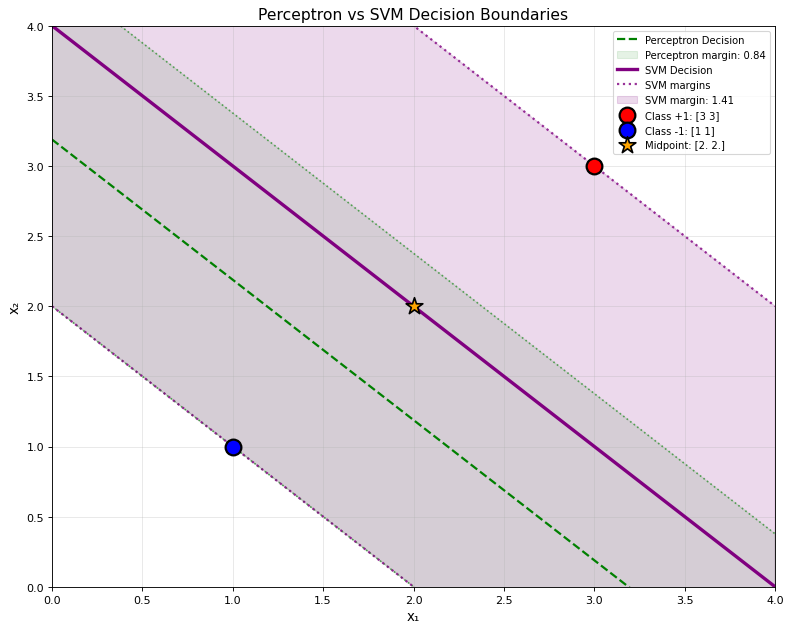

Perceptron margin: 0.840
SVM margin: 1.414
Improvement: 1.68x


{'perceptron_margin': np.float64(0.840493889085575),
 'svm_margin': np.float64(1.414213562373095),
 'perceptron_weights': array([ 1.3705408 ,  1.3705408 , -4.37015829]),
 'optimal_weights': array([ 2.,  2., -8.])}

In [59]:
plot_perceptron_vs_svm(x1, x2, final_weights)

In Algorithm 2:

1. The perceptron margin (0.84) was larger than Algorithm 1 (0.77), showing a better boundary. This shows that incorporating a loss function helped in finding a more optimal decision boundary for this dataset, which is expected.

## Overall Conclusion

**For Algorithm 1:**

- Updates weights only on misclassifiication
- Simple and efficient due to simple stopping criteria
- No minimization of loss function, may not find the most optimal boundary as seen in the plots


**For Algorithm 2:**
- Uses a loss function to adjust the weights to minimise overall error over time
- Weights are updated based on an error function, the l2 of the difference between predicted and target output.
- Smaller learning rate was used to ensure slower and smoother updates, leading to better convergence.
- May take longer to train than Algorithm 1

FIN
